# Neural Structured Learning on Time Series - Fictitious dataset

Two novelties are implemented in this notebook:
* Use the GraphNet framework for implementing algorithms with inductive biases for time-series
* Use implicit reparametrization gradients to learn with SGD the parameters of a gamma distribution instead of an empirical error on the output. This is closer to reality and should work better.


## Load data:

In [1]:
from collections import OrderedDict
import os
import tensorflow as tf
import tensorflow_probability as tfp
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession
from tensorflow.keras.layers import Input, Dense, Conv1D, GlobalAveragePooling1D, Dropout
from tensorflow.keras import Sequential,Model
import tensorflow.keras as keras
tf.keras.backend.set_floatx('float64')
config = ConfigProto()
config.gpu_options.allow_growth = True
sess = InteractiveSession(config=config)

import numpy as np
import matplotlib.pyplot as pplot
tfd = tfp.distributions
from ipywidgets import FloatSlider, IntSlider, interact, interactive
from datasets.femto_bearing import FEMTOBearingsDataset

import pandas as pd

from minigraphnets import Edge,Node, Graph
from graphnet_utils import GraphNet, GraphNetFunctionFactory

#from datasets.femto_bearing import FEMTOBearingsDataset


not running in colab.


In [2]:
import tensorflow_probability as tfp
from tensorflow_probability import distributions


In [3]:
femto_dataset = FEMTOBearingsDataset()

training set:
00 1 1_1 2803
03 1 1_4 1428
04 1 1_5 2463
05 1 1_6 2448
06 1 1_7 2259
07 2 2_1 911
09 2 2_3 1955
11 2 2_5 2311
15 3 3_2 1637

testing set:
16 3 3_3 434
02 1 1_3 2375


## Loading the train/test sets

In [4]:
get_x_eid = lambda eid : femto_dataset.X[femto_dataset.eid==eid]

In [5]:
femto_dataset.inds_exp_source


[0, 3, 4, 5, 6, 7, 9, 11, 15]

In [6]:
#femto_dataset.inds_exp_source.append(11)
#femto_dataset.inds_exp_source.append(12)
#femto_dataset.inds_exp_source.remove(8)
#femto_dataset.inds_exp_target.append(8)
# femto_dataset.inds_exp_source.remove(1)
# femto_dataset.inds_exp_source.remove(9)
# femto_dataset.inds_exp_source.append(3)
#femto_dataset.inds_exp_source.append(12)

#femto_dataset.inds_exp_source.remove(5)#femto_dataset.inds_exp_source.append(0)



In [7]:
help(femto_dataset.get_data_bearings_RUL)

Help on method get_data_bearings_RUL in module datasets.femto_bearing:

get_data_bearings_RUL(min_samples_keep=910, normalization_factor_time=25000, yrem_norm_thresh=0.0001) method of datasets.femto_bearing.FEMTOBearingsDataset instance



In [8]:

#get_inds_for_cond = lambda x : [femto_dataset.eid_index_to_cond_dict

In [9]:
femto_dataset.all_files

['Full_1_1.pickle',
 'Full_1_2.pickle',
 'Full_1_3.pickle',
 'Full_1_4.pickle',
 'Full_1_5.pickle',
 'Full_1_6.pickle',
 'Full_1_7.pickle',
 'Full_2_1.pickle',
 'Full_2_2.pickle',
 'Full_2_3.pickle',
 'Full_2_4.pickle',
 'Full_2_5.pickle',
 'Full_2_6.pickle',
 'Full_2_7.pickle',
 'Full_3_1.pickle',
 'Full_3_2.pickle',
 'Full_3_3.pickle']

In [16]:
# The default cencored dataset:
# learning_set = ['1_3','1_2','1_4','1_5','2_1','2_2','2_5','2_6','2_7','3_1','3_2']
learning_set = ['1_3','1_2','1_4','1_5','2_1','2_5','2_6','3_3'] # Giving decent results.
learning_set = ['1_3','1_2','1_4','1_5','2_1','2_5','3_2','3_3'] # Giving decent results.
learning_set = ['1_2','1_3','1_4','1_5','2_1','2_5','2_6','3_3'] # Giving decent results.
#learning_set = ['1_3','1_2','1_4','1_5','2_1','2_5','3_2','3_3'] # Giving decent results.
# learning_set = ['1_3','1_2','1_4','1_5','1_7','2_1','2_5','2_6','3_3'] # Giving decent results.
# learning_set = ['1_3','1_2','1_4','1_5',      '2_1','2_5','2_6','3_3'] # Giving decent results.
# learning_set = ['1_3','1_2','1_4','1_5','2_2','2_1','2_5','2_6','3_3'] # Giving decent results.
#learning_set = ['1_3','1_1','1_4','1_5','2_3','2_5','3_3'] # Giving decent results.

#learning_set.extend([femto_dataset.file_suffix[k_] for k_ in [3,4,5,,10]])
print(learning_set)
learning_set_inds = [femto_dataset.file_suffix.index(k) for k in learning_set]
eval_inds = [f for f in femto_dataset.file_suffix if f not in learning_set]

val_set_inds = [femto_dataset.file_suffix.index(k) for k in eval_inds]
APPLY_DEFAULT_SETUP = True
if APPLY_DEFAULT_SETUP:
    femto_dataset.inds_exp_source = learning_set_inds
    femto_dataset.inds_exp_target = val_set_inds
    

['1_2', '1_3', '1_4', '1_5', '2_1', '2_5', '2_6', '3_3']


In [17]:
help(tf.nn.softplus)

Help on function softplus in module tensorflow.python.ops.gen_nn_ops:

softplus(features, name=None)
    Computes softplus: `log(exp(features) + 1)`.
    
    Args:
      features: A `Tensor`. Must be one of the following types: `half`, `bfloat16`, `float32`, `float64`.
      name: A name for the operation (optional).
    
    Returns:
      A `Tensor`. Has the same type as `features`.



In [18]:
femto_dataset.inds_exp_source, femto_dataset.inds_exp_target

([1, 2, 3, 4, 7, 11, 12, 16], [0, 5, 6, 8, 9, 10, 13, 14, 15])

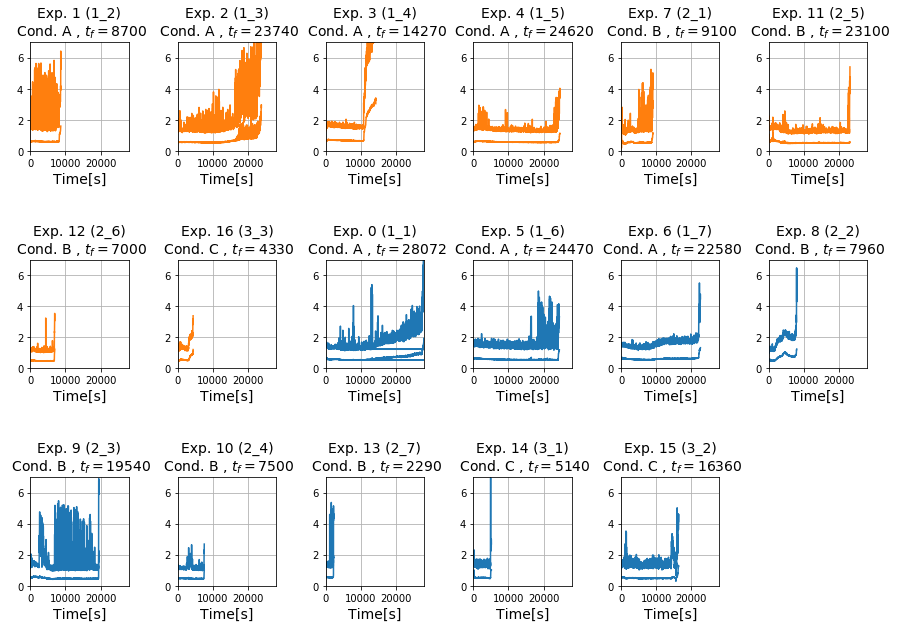

In [35]:
pplot.figure(figsize = (15,10))

ftsize = 14

pp = [r for r in range(0,17 )]
pp = [*learning_set_inds,*val_set_inds]
for plot_pos, kk in enumerate(pp):#np.unique(femto_dataset.eid):
    c = 'C0'
    if kk in femto_dataset.inds_exp_source:
        c = 'C1'
    #if kk in femto_dataset.inds_exp_target:
    #    c = 'C2'
    times= femto_dataset.yrem_s_raw[femto_dataset.eid==kk]
    tfail = np.max(times)
    pplot.subplot(3,6,plot_pos+1)
    dd = get_x_eid(kk)
    dd = np.sqrt(np.abs(dd[:,:,0]+dd[:,:,1]))
    
    pplot.plot(times[::-1],np.max(np.abs(dd),1), c)
    pplot.plot(times[::-1],np.mean(np.abs(dd),1), c)
    
    pplot.xlim([0,28000])
    pplot.ylim([0,7])
    pplot.xlabel("Time[s]", fontsize = ftsize)
    cond_ind = femto_dataset.exp_to_cond_dict[kk]
    
    pplot.title("Exp. %i (%s)"%(kk,femto_dataset.file_suffix[kk]) + "\n Cond. %s , $t_f = %1.2i$"%(' ABC'[cond_ind],tfail), fontsize = ftsize)
    
    pplot.grid()
    #pplot.show()
    
    
pplot.subplots_adjust(hspace=1, wspace=0.5)
#pplot.plot(np.std(get_x_eid(11),1))
pplot.savefig("bearing_experiments.pdf")

In [36]:
!cp bearing_experiments.pdf /home/charilaos/current/paper/figures/

In [20]:
femto_dataset.X[femto_dataset.eid==0].shape

(2803, 2559, 2)

In [15]:
inds_source = femto_dataset.inds_exp_source
training_conds = [femto_dataset.exp_to_cond_dict[i] for i in inds_source]
inds_target = [v_ for v_ in np.unique(femto_dataset.eid) if v_ not in femto_dataset.inds_exp_source]
test_conds = [femto_dataset.exp_to_cond_dict[i] for i in inds_target]
get_exp_max_time = lambda x : np.max(femto_dataset.yrem_s_raw[femto_dataset.eid == x])
count_exp = lambda x : len(femto_dataset.yrem_s_raw[femto_dataset.eid == x])

header = ["Experiment index","Experiment","Conditions" ,"Number of observations", "Failure time [s]"]
print("\\begin{table}")
print("\\begin{tabular}")
conds_to_string = ' ABC'
print("   " + " & ".join(header) + " \\\\")

for si,sc in zip(inds_source, training_conds):
    print("   " + "%i & %s & %s & %i & %i \\\\"%(si,femto_dataset.file_suffix[si],conds_to_string[sc],get_exp_max_time(si),count_exp(si)))

print('\hline \\\\')
for si,sc in zip(inds_target, test_conds):
    print("   " + "%i & %s & %s & %i & %i \\\\"%(si,femto_dataset.file_suffix[si],conds_to_string[sc],get_exp_max_time(si),count_exp(si)))

    
print("\end{tabular}")
print("\end{table}")


\begin{table}
\begin{tabular}
   Experiment index & Experiment & Conditions & Number of observations & Failure time [s] \\
   2 & 1_3 & A & 23740 & 2375 \\
   1 & 1_2 & A & 8700 & 871 \\
   3 & 1_4 & A & 14270 & 1428 \\
   4 & 1_5 & A & 24620 & 2463 \\
   7 & 2_1 & B & 9100 & 911 \\
   11 & 2_5 & B & 23100 & 2311 \\
   15 & 3_2 & C & 16360 & 1637 \\
   16 & 3_3 & C & 4330 & 434 \\
\hline \\
   0 & 1_1 & A & 28072 & 2803 \\
   5 & 1_6 & A & 24470 & 2448 \\
   6 & 1_7 & A & 22580 & 2259 \\
   8 & 2_2 & B & 7960 & 797 \\
   9 & 2_3 & B & 19540 & 1955 \\
   10 & 2_4 & B & 7500 & 751 \\
   12 & 2_6 & B & 7000 & 701 \\
   13 & 2_7 & B & 2290 & 230 \\
   14 & 3_1 & C & 5140 & 515 \\
\end{tabular}
\end{table}


In [16]:
inds_exp_target, inds_exp_source = [femto_dataset.inds_exp_target, femto_dataset.inds_exp_source]

In [17]:
assert(len(set(inds_exp_source).intersection(inds_exp_target)) == 0)

In **GraphNets** some code to make graph inputs for this dataset. The graph encodes in practice the *inductive biases* we are baking into the algorithm. In particular, in this application we are representing the following biases:
* The slow progression of damage may be inferred from arbitrary pairs of points
* Averaging estimates from several points yields better estimates than from fewer ones


In [20]:
from utils import get_indices, data_from_experiment, get_graph_data, get_graph_data_multiple_experiments, get_multi_batch

# Definition of GraphNet functions and the GraphNet:

In [21]:

gtot = GraphNetFunctionFactory(network_size_global = 50,use_prenetworks= True, edge_node_state_size=15)
gtot.make_graphnet_comp_blocks( femto_dataset.X[0].shape[0])
graphnet = gtot.core



In [23]:
d = get_multi_batch(1,femto_dataset, nseq_range=200, nnodes = 50, min_spacing=2)
#graph = 
#graph.edges

In [24]:

# g1 = gtot.graph_indep.graph_eval(d[0][0].copy(), eval_mode = "batched")
# g2 = gtot.graph_indep.graph_eval(d[0][0].copy(), eval_mode = "safe")


In [25]:
# g1.nodes[2].node_attr_tensor - g2.nodes[2].node_attr_tensor

In [26]:
from tqdm import tqdm

In [27]:

# new_graph = d[0][0].copy()

# # for e in new_graph.edges:
# #     e.edge_tensor = e.edge_tensor.astype("float64")
# nreps = 5
# import time
# t1 = time.time()
# for k in tqdm(range(nreps)):    
#     g1 = gtot.core.graph_eval(gtot.graph_indep.graph_eval(new_graph.copy(), eval_mode="safe"),eval_mode = 'safe')
# dt1 = (time.time() - t1)/nreps

# t1 = time.time()
# for k in tqdm(range(nreps)):
#     g2 = gtot.core.graph_eval(gtot.graph_indep.graph_eval(new_graph.copy(), eval_mode="batched"), eval_mode = "batched")
# dt2 = (time.time() - t1)/nreps
# print("improvement: %2.2f pct new/old time: %2.2f"%((dt1-dt2)/dt1*100, dt2/dt1))



In [28]:
#(g1.edges[1].edge_tensor - g2.edges[1].edge_tensor)/g1.edges[1].edge_tensor
# pplot.pcolor(np.vstack([e.edge_tensor.numpy() for e in g1.edges]))
# pplot.show()
# pplot.pcolor(np.vstack([e.edge_tensor.numpy() for e in g2.edges]))


In [29]:
#gtot.make_graphnet_comp_blocks(femto_dataset.X[0].shape[0])
#gtot.save("/tmp/testtt")


# Model Creation:


In [30]:
help(GraphNetFunctionFactory)

Help on class GraphNetFunctionFactory in module graphnet_utils:

class GraphNetFunctionFactory(builtins.object)
 |  Methods defined here:
 |  
 |  __init__(self, network_size_global=50, use_prenetworks=True, edge_node_state_size=15, graph_function_output_activation='gated_tanh', n_conv_blocks=3, nfilts=18, nfilts2=50, ksize=3, conv_block_activation_type='leaky_relu', channels_in=2)
 |      Summary: 
 |        A factory for graphnet functions. It is custom-made for the problems of RUL from time-series. 
 |        It can be adapted to other prediction models. All models (except the aggregation function) are 
 |        relatively small MLPs terminated by sigmoid()*tanh() activation (simple tanh could also work).
 |        
 |      network_size_global: A parameter controlling the width of different networks involved.
 |      
 |      use_prenetworks:     Use a deeper architecture (see code)
 |      
 |      edge_node_state_size:  the size of the node states, and edge states. This is needed

In [31]:
gn_tot = GraphNetFunctionFactory(network_size_global = 30, 
                                 use_prenetworks = True,
                                 edge_node_state_size= 50)

gn_tot.make_graphnet_comp_blocks(femto_dataset.X[0].shape[0])


# Training

In [32]:
def get_multi_batch_femto(*args, **kwargs):
    new_args = (args[0], femto_dataset)        
    return get_multi_batch(*new_args, **kwargs)

In [33]:
curr_data = get_multi_batch_femto(3, source_ds=True,nnodes=5,
                            min_spacing = 1,
                            nseq_range = 100,
                            fixed_spacing_indices=False);
#eval_graphnets(curr_data[0][0].copy())

In [34]:
class LossLogger:
    def __init__(self):
        self.losses  = ["loss", "val_loss"]
        self.loss_history = {k:[] for k in self.losses}
    def append_loss(self, loss_):
        self.loss_history['loss'].append(loss_)
        
    def append_val_loss(self, val_loss_):
        self.loss_history['val_loss'].append(val_loss_)
    
    def print(self):
        loss, val_loss = [self.loss_history[vv] for vv in self.losses]
        print("loss: %2.3f, val_loss %2.3f"%(loss[-1], val_loss[-1]))

class EarlyStopping:
    def __init__(self, patience, loss_handle):
        self.patience = patience
        self.loss_handle = loss_handle
    
    def on_epoch_end(self, epoch):
        break_ = False
        
        if len(self.loss_handle) > 1:
            if np.all(np.min(self.loss_handle[-self.patience:]) > self.min_val):
                print("*** Early stopping. ***")
                break_ = True
                
            else:
                self.min_val = np.min(self.loss_handle)
        else:
            
            self.min_val = self.loss_handle[-1]
        
        return break_
    
class LRScheduler:
    def __init__(self, opt_object, epoch_decay = 50, decay_rate = 0.95):
        self.opt_object = opt_object
        self.epoch_decay = epoch_decay
        self.decay_rate = decay_rate
        
    def on_epoch_end(self,epoch):
        if epoch >= self.epoch_decay:
            lr = self.opt_object.lr.numpy()
            new_lr = lr * self.decay_rate
            print("setting lr to %2.3f"%new_lr)
            self.opt_object.lr.assign(new_lr)
        
        

In [35]:
learning_rate = 0.001;
opt = tf.keras.optimizers.Adam(learning_rate = learning_rate)
loss_log = LossLogger()
early_stop = EarlyStopping(50,loss_log.loss_history['val_loss'])
lr_scheduler = LRScheduler(opt, epoch_decay = 60, decay_rate = 0.99)

In [36]:

#@tf.function
# def eval_graphnets(graph_data_, iterations = 2):
#     graph_out = graph_indep.graph_eval(graph_data_)
#     for iterations in range(iterations):
#         graph_out = gn.graph_eval(graph_out) + graph_out
        
#     return node_to_prob_mlp(graph_out.nodes[-1].node_attr_tensor)

#@tf.function
def eval_graphnets_loss(graph_curr_, ycurr_, iterations):#,iterations):
    graph_out = graph_indep.graph_eval(graph_curr_)
    
    for iterations in range(iterations):
        graph_out = gn.graph_eval(graph_out) + graph_out

    prob_out = node_to_prob_mlp(graph_out.nodes[-1].node_attr_tensor)
    loss_vals = -prob_out.log_prob(ycurr_)
    return loss_vals


def graphnet_latent_states(graph_data_, iterations = 2):
    graph_out_tmp = graph_indep.graph_eval(graph_data_)
    lat_states = [graph_out_tmp.copy()]
    for iterations in range(iterations):
        graph_out_tmp = gn.graph_eval(graph_out_tmp) + graph_out
        lat_states.append(graph_out_tmp.copy())
    return lat_states

In [37]:
#lr_scheduler.opt_object.lr.assign(lr_scheduler.opt_object.lr.numpy()*0.9)
#lr_scheduler.opt_object.lr.assign(0.005)

In [38]:
#gn_tot.eval_graphnets(graph_curr.copy(), iterations)
from tqdm import tqdm

  0%|          | 0/300 [00:00<?, ?it/s]

nnodes: 1, seq_range 200 epoch: 0
loss: 11.645, val_loss 12.549


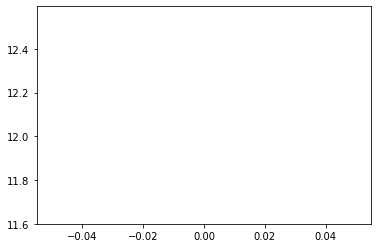

  0%|          | 1/300 [00:20<1:43:27, 20.76s/it]

nnodes: 2, seq_range 150 epoch: 1


  1%|          | 2/300 [00:43<1:45:18, 21.20s/it]

loss: 10.134, val_loss 10.340
nnodes: 5, seq_range 100 epoch: 2


  1%|          | 3/300 [01:06<1:48:23, 21.90s/it]

loss: 9.897, val_loss 11.378
nnodes: 10, seq_range 200 epoch: 3


  1%|▏         | 4/300 [01:33<1:55:52, 23.49s/it]

loss: 9.666, val_loss 10.386
nnodes: 1, seq_range 150 epoch: 4


  2%|▏         | 5/300 [01:34<1:22:09, 16.71s/it]

loss: 10.044, val_loss 10.030
nnodes: 2, seq_range 100 epoch: 5


  2%|▏         | 6/300 [01:35<59:18, 12.10s/it]  

loss: 10.096, val_loss 11.564
nnodes: 5, seq_range 200 epoch: 6


  2%|▏         | 7/300 [01:38<44:51,  9.19s/it]

loss: 9.660, val_loss 10.408
nnodes: 10, seq_range 150 epoch: 7


  3%|▎         | 8/300 [01:42<37:18,  7.67s/it]

loss: 9.468, val_loss 9.174
nnodes: 1, seq_range 100 epoch: 8


  3%|▎         | 9/300 [01:43<27:29,  5.67s/it]

loss: 10.068, val_loss 11.465
nnodes: 2, seq_range 200 epoch: 9


  3%|▎         | 10/300 [01:44<21:05,  4.36s/it]

loss: 10.087, val_loss 10.808
nnodes: 5, seq_range 150 epoch: 10
loss: 9.643, val_loss 9.599


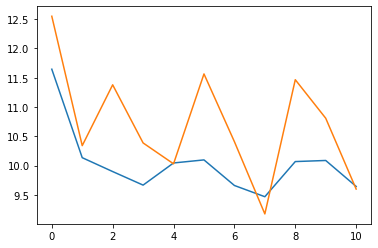

  4%|▎         | 11/300 [01:47<18:15,  3.79s/it]

nnodes: 10, seq_range 100 epoch: 11


  4%|▍         | 12/300 [01:51<18:36,  3.88s/it]

loss: 9.811, val_loss 11.205
nnodes: 1, seq_range 200 epoch: 12


  4%|▍         | 13/300 [01:52<14:12,  2.97s/it]

loss: 10.028, val_loss 10.829
nnodes: 2, seq_range 150 epoch: 13


  5%|▍         | 14/300 [01:53<11:46,  2.47s/it]

loss: 9.786, val_loss 9.653
nnodes: 5, seq_range 100 epoch: 14


  5%|▌         | 15/300 [01:55<11:32,  2.43s/it]

loss: 9.913, val_loss 11.283
nnodes: 10, seq_range 200 epoch: 15


  5%|▌         | 16/300 [01:59<13:52,  2.93s/it]

loss: 9.530, val_loss 10.294
nnodes: 1, seq_range 150 epoch: 16


  6%|▌         | 17/300 [02:00<10:55,  2.32s/it]

loss: 9.799, val_loss 9.790
nnodes: 2, seq_range 100 epoch: 17


  6%|▌         | 18/300 [02:02<09:27,  2.01s/it]

loss: 9.993, val_loss 11.464
nnodes: 5, seq_range 200 epoch: 18


  6%|▋         | 19/300 [02:04<10:01,  2.14s/it]

loss: 9.637, val_loss 10.442
nnodes: 10, seq_range 150 epoch: 19


  7%|▋         | 20/300 [02:08<12:42,  2.72s/it]

loss: 9.074, val_loss 8.871
nnodes: 1, seq_range 100 epoch: 20
loss: 9.796, val_loss 11.301


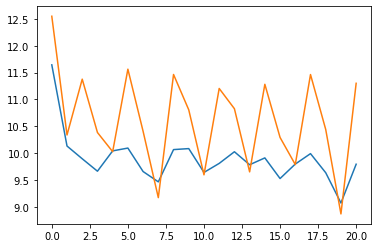

  7%|▋         | 21/300 [02:09<10:13,  2.20s/it]

nnodes: 2, seq_range 200 epoch: 21


  7%|▋         | 22/300 [02:10<08:56,  1.93s/it]

loss: 9.319, val_loss 10.454
nnodes: 5, seq_range 150 epoch: 22


  8%|▊         | 23/300 [02:13<09:27,  2.05s/it]

loss: 8.831, val_loss 9.073
nnodes: 10, seq_range 100 epoch: 23


  8%|▊         | 24/300 [02:17<12:09,  2.64s/it]

loss: 9.171, val_loss 10.083
nnodes: 1, seq_range 200 epoch: 24


  8%|▊         | 25/300 [02:18<09:38,  2.11s/it]

loss: 9.497, val_loss 10.400
nnodes: 2, seq_range 150 epoch: 25


  9%|▊         | 26/300 [02:19<08:30,  1.86s/it]

loss: 9.558, val_loss 9.763
nnodes: 5, seq_range 100 epoch: 26


  9%|▉         | 27/300 [02:21<09:07,  2.00s/it]

loss: 8.639, val_loss 9.799
nnodes: 10, seq_range 200 epoch: 27


  9%|▉         | 28/300 [02:25<11:53,  2.62s/it]

loss: 9.084, val_loss 10.313
nnodes: 1, seq_range 150 epoch: 28


 10%|▉         | 29/300 [02:26<09:26,  2.09s/it]

loss: 8.834, val_loss 8.685
nnodes: 2, seq_range 100 epoch: 29


 10%|█         | 30/300 [02:27<08:21,  1.86s/it]

loss: 9.143, val_loss 10.603
nnodes: 5, seq_range 200 epoch: 30
loss: 7.624, val_loss 8.421


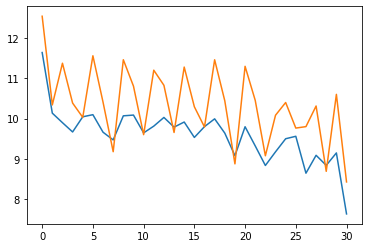

 10%|█         | 31/300 [02:30<09:07,  2.04s/it]

nnodes: 10, seq_range 150 epoch: 31


 11%|█         | 32/300 [02:34<11:46,  2.63s/it]

loss: 8.776, val_loss 10.921
nnodes: 1, seq_range 100 epoch: 32


 11%|█         | 33/300 [02:35<09:19,  2.10s/it]

loss: 8.332, val_loss 9.745
nnodes: 2, seq_range 200 epoch: 33


 11%|█▏        | 34/300 [02:36<08:13,  1.86s/it]

loss: 8.971, val_loss 9.828
nnodes: 5, seq_range 150 epoch: 34


 12%|█▏        | 35/300 [02:38<08:48,  1.99s/it]

loss: 7.866, val_loss 8.080
nnodes: 10, seq_range 100 epoch: 35


 12%|█▏        | 36/300 [02:42<11:27,  2.61s/it]

loss: 8.052, val_loss 9.519
nnodes: 1, seq_range 200 epoch: 36


 12%|█▏        | 37/300 [02:43<09:05,  2.08s/it]

loss: 7.986, val_loss 9.035
nnodes: 2, seq_range 150 epoch: 37


 13%|█▎        | 38/300 [02:45<08:02,  1.84s/it]

loss: 7.856, val_loss 9.401
nnodes: 5, seq_range 100 epoch: 38


 13%|█▎        | 39/300 [02:47<08:49,  2.03s/it]

loss: 7.301, val_loss 8.589
nnodes: 10, seq_range 200 epoch: 39


 13%|█▎        | 40/300 [02:51<11:23,  2.63s/it]

loss: 7.626, val_loss 9.231
nnodes: 1, seq_range 150 epoch: 40
loss: 7.591, val_loss 7.331


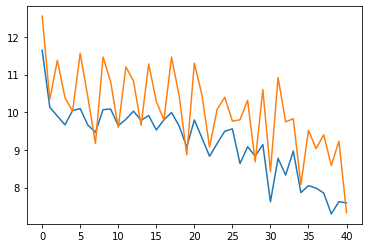

 14%|█▎        | 41/300 [02:52<09:11,  2.13s/it]

nnodes: 2, seq_range 100 epoch: 41


 14%|█▍        | 42/300 [02:53<08:05,  1.88s/it]

loss: 7.745, val_loss 9.457
nnodes: 5, seq_range 200 epoch: 42


 14%|█▍        | 43/300 [02:56<08:36,  2.01s/it]

loss: 6.454, val_loss 7.404
nnodes: 10, seq_range 150 epoch: 43


 15%|█▍        | 44/300 [03:00<11:08,  2.61s/it]

loss: 7.501, val_loss 9.213
nnodes: 1, seq_range 100 epoch: 44


 15%|█▌        | 45/300 [03:00<08:50,  2.08s/it]

loss: 7.126, val_loss 8.725
nnodes: 2, seq_range 200 epoch: 45


 15%|█▌        | 46/300 [03:02<07:47,  1.84s/it]

loss: 8.836, val_loss 10.471
nnodes: 5, seq_range 150 epoch: 46


 16%|█▌        | 47/300 [03:04<08:22,  1.98s/it]

loss: 7.082, val_loss 7.001
nnodes: 10, seq_range 100 epoch: 47


 16%|█▌        | 48/300 [03:08<10:58,  2.61s/it]

loss: 7.382, val_loss 8.852
nnodes: 1, seq_range 200 epoch: 48


 16%|█▋        | 49/300 [03:09<08:41,  2.08s/it]

loss: 7.091, val_loss 8.275
nnodes: 2, seq_range 150 epoch: 49


 17%|█▋        | 50/300 [03:10<07:40,  1.84s/it]

loss: 6.776, val_loss 8.166
nnodes: 5, seq_range 100 epoch: 50
loss: 6.431, val_loss 8.249


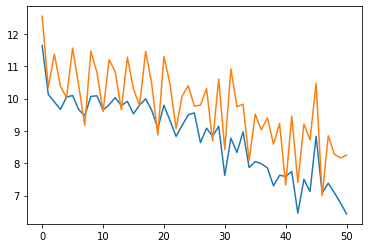

 17%|█▋        | 51/300 [03:13<08:22,  2.02s/it]

nnodes: 10, seq_range 200 epoch: 51


 17%|█▋        | 52/300 [03:17<10:50,  2.62s/it]

loss: 6.266, val_loss 7.833
nnodes: 1, seq_range 150 epoch: 52


 18%|█▊        | 53/300 [03:18<08:35,  2.09s/it]

loss: 6.970, val_loss 7.838
nnodes: 2, seq_range 100 epoch: 53


 18%|█▊        | 54/300 [03:19<07:35,  1.85s/it]

loss: 6.302, val_loss 8.959
nnodes: 5, seq_range 200 epoch: 54


 18%|█▊        | 55/300 [03:21<08:08,  1.99s/it]

loss: 5.716, val_loss 6.335
nnodes: 10, seq_range 150 epoch: 55


 19%|█▊        | 56/300 [03:25<10:35,  2.61s/it]

loss: 5.955, val_loss 7.577
nnodes: 1, seq_range 100 epoch: 56


 19%|█▉        | 57/300 [03:26<08:23,  2.07s/it]

loss: 9.045, val_loss 11.317
nnodes: 2, seq_range 200 epoch: 57


 19%|█▉        | 58/300 [03:27<07:26,  1.85s/it]

loss: 6.846, val_loss 7.667
nnodes: 5, seq_range 150 epoch: 58


 20%|█▉        | 59/300 [03:30<08:09,  2.03s/it]

loss: 6.160, val_loss 6.732
nnodes: 10, seq_range 100 epoch: 59


 20%|██        | 60/300 [03:34<10:32,  2.64s/it]

loss: 7.282, val_loss 9.073
nnodes: 1, seq_range 200 epoch: 60
loss: 6.377, val_loss 7.434
setting lr to 0.001


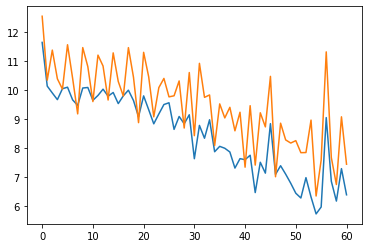

 20%|██        | 61/300 [03:35<08:29,  2.13s/it]

nnodes: 2, seq_range 150 epoch: 61


 21%|██        | 62/300 [03:36<07:27,  1.88s/it]

loss: 6.154, val_loss 7.283
setting lr to 0.001
nnodes: 5, seq_range 100 epoch: 62


 21%|██        | 63/300 [03:38<07:56,  2.01s/it]

loss: 5.483, val_loss 7.760
setting lr to 0.001
nnodes: 10, seq_range 200 epoch: 63


 21%|██▏       | 64/300 [03:43<10:19,  2.63s/it]

loss: 4.925, val_loss 5.856
setting lr to 0.001
nnodes: 1, seq_range 150 epoch: 64


 22%|██▏       | 65/300 [03:43<08:10,  2.09s/it]

loss: 6.683, val_loss 8.439
setting lr to 0.001
nnodes: 2, seq_range 100 epoch: 65


 22%|██▏       | 66/300 [03:45<07:13,  1.85s/it]

loss: 5.053, val_loss 8.181
setting lr to 0.001
nnodes: 5, seq_range 200 epoch: 66


 22%|██▏       | 67/300 [03:47<07:44,  1.99s/it]

loss: 4.868, val_loss 6.034
setting lr to 0.001
nnodes: 10, seq_range 150 epoch: 67


 23%|██▎       | 68/300 [03:51<10:11,  2.63s/it]

loss: 5.703, val_loss 8.014
setting lr to 0.001
nnodes: 1, seq_range 100 epoch: 68


 23%|██▎       | 69/300 [03:52<08:04,  2.10s/it]

loss: 6.167, val_loss 7.894
setting lr to 0.001
nnodes: 2, seq_range 200 epoch: 69


 23%|██▎       | 70/300 [03:53<07:06,  1.85s/it]

loss: 5.152, val_loss 6.888
setting lr to 0.001
nnodes: 5, seq_range 150 epoch: 70
loss: 4.452, val_loss 5.090
setting lr to 0.001


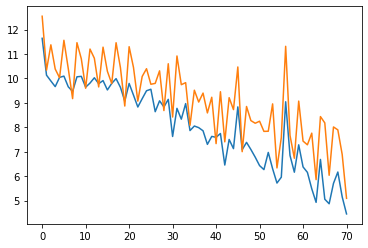

 24%|██▎       | 71/300 [03:56<07:47,  2.04s/it]

nnodes: 10, seq_range 100 epoch: 71


 24%|██▍       | 72/300 [04:00<10:06,  2.66s/it]

loss: 5.214, val_loss 7.282
setting lr to 0.001
nnodes: 1, seq_range 200 epoch: 72


 24%|██▍       | 73/300 [04:01<07:58,  2.11s/it]

loss: 5.946, val_loss 7.682
setting lr to 0.001
nnodes: 2, seq_range 150 epoch: 73


 25%|██▍       | 74/300 [04:02<07:01,  1.86s/it]

loss: 5.414, val_loss 5.956
setting lr to 0.001
nnodes: 5, seq_range 100 epoch: 74


 25%|██▌       | 75/300 [04:04<07:30,  2.00s/it]

loss: 4.315, val_loss 7.143
setting lr to 0.001
nnodes: 10, seq_range 200 epoch: 75


 25%|██▌       | 76/300 [04:08<09:45,  2.62s/it]

loss: 4.548, val_loss 6.429
setting lr to 0.001
nnodes: 1, seq_range 150 epoch: 76


 26%|██▌       | 77/300 [04:09<07:45,  2.09s/it]

loss: 6.228, val_loss 7.336
setting lr to 0.001
nnodes: 2, seq_range 100 epoch: 77


 26%|██▌       | 78/300 [04:11<06:52,  1.86s/it]

loss: 5.404, val_loss 8.165
setting lr to 0.001
nnodes: 5, seq_range 200 epoch: 78


 26%|██▋       | 79/300 [04:13<07:24,  2.01s/it]

loss: 5.109, val_loss 7.058
setting lr to 0.001
nnodes: 10, seq_range 150 epoch: 79


 27%|██▋       | 80/300 [04:17<09:48,  2.68s/it]

loss: 3.824, val_loss 5.296
setting lr to 0.001
nnodes: 1, seq_range 100 epoch: 80
loss: 5.088, val_loss 7.243
setting lr to 0.001


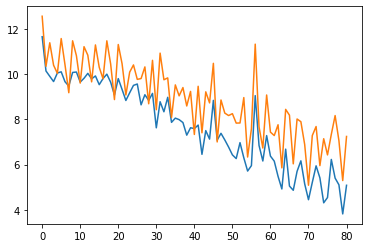

 27%|██▋       | 81/300 [04:18<07:52,  2.16s/it]

nnodes: 2, seq_range 200 epoch: 81


 27%|██▋       | 82/300 [04:19<06:54,  1.90s/it]

loss: 4.732, val_loss 5.957
setting lr to 0.001
nnodes: 5, seq_range 150 epoch: 82


 28%|██▊       | 83/300 [04:22<07:19,  2.03s/it]

loss: 3.977, val_loss 4.749
setting lr to 0.001
nnodes: 10, seq_range 100 epoch: 83


 28%|██▊       | 84/300 [04:26<09:28,  2.63s/it]

loss: 3.728, val_loss 6.052
setting lr to 0.001
nnodes: 1, seq_range 200 epoch: 84


 28%|██▊       | 85/300 [04:27<07:29,  2.09s/it]

loss: 4.894, val_loss 6.301
setting lr to 0.001
nnodes: 2, seq_range 150 epoch: 85


 29%|██▊       | 86/300 [04:28<06:36,  1.85s/it]

loss: 3.957, val_loss 6.908
setting lr to 0.001
nnodes: 5, seq_range 100 epoch: 86


 29%|██▉       | 87/300 [04:30<07:04,  1.99s/it]

loss: 4.363, val_loss 7.547
setting lr to 0.001
nnodes: 10, seq_range 200 epoch: 87


 29%|██▉       | 88/300 [04:34<09:17,  2.63s/it]

loss: 3.849, val_loss 5.953
setting lr to 0.001
nnodes: 1, seq_range 150 epoch: 88


 30%|██▉       | 89/300 [04:35<07:20,  2.09s/it]

loss: 5.321, val_loss 6.929
setting lr to 0.001
nnodes: 2, seq_range 100 epoch: 89


 30%|███       | 90/300 [04:36<06:28,  1.85s/it]

loss: 6.147, val_loss 9.509
setting lr to 0.001
nnodes: 5, seq_range 200 epoch: 90
loss: 3.062, val_loss 3.974
setting lr to 0.001


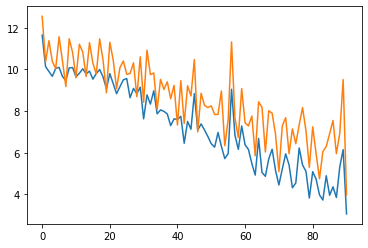

 30%|███       | 91/300 [04:39<07:03,  2.02s/it]

nnodes: 10, seq_range 150 epoch: 91


 31%|███       | 92/300 [04:43<09:06,  2.63s/it]

loss: 3.341, val_loss 4.827
setting lr to 0.001
nnodes: 1, seq_range 100 epoch: 92


 31%|███       | 93/300 [04:44<07:12,  2.09s/it]

loss: 4.745, val_loss 6.737
setting lr to 0.001
nnodes: 2, seq_range 200 epoch: 93


 31%|███▏      | 94/300 [04:45<06:20,  1.85s/it]

loss: 3.576, val_loss 4.656
setting lr to 0.001
nnodes: 5, seq_range 150 epoch: 94


 32%|███▏      | 95/300 [04:47<06:47,  1.99s/it]

loss: 3.435, val_loss 5.337
setting lr to 0.001
nnodes: 10, seq_range 100 epoch: 95


 32%|███▏      | 96/300 [04:51<08:51,  2.61s/it]

loss: 3.044, val_loss 5.703
setting lr to 0.001
nnodes: 1, seq_range 200 epoch: 96


 32%|███▏      | 97/300 [04:52<07:00,  2.07s/it]

loss: 4.279, val_loss 6.414
setting lr to 0.001
nnodes: 2, seq_range 150 epoch: 97


 33%|███▎      | 98/300 [04:53<06:11,  1.84s/it]

loss: 3.301, val_loss 6.913
setting lr to 0.001
nnodes: 5, seq_range 100 epoch: 98


 33%|███▎      | 99/300 [04:56<06:38,  1.98s/it]

loss: 2.538, val_loss 5.068
setting lr to 0.001
nnodes: 10, seq_range 200 epoch: 99


 33%|███▎      | 100/300 [05:00<08:46,  2.63s/it]

loss: 1.828, val_loss 2.108
setting lr to 0.001
nnodes: 1, seq_range 150 epoch: 100
loss: 3.762, val_loss 6.766
setting lr to 0.001


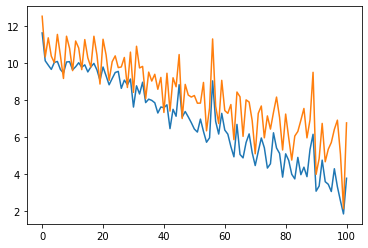

 34%|███▎      | 101/300 [05:01<07:02,  2.12s/it]

nnodes: 2, seq_range 100 epoch: 101


 34%|███▍      | 102/300 [05:02<06:11,  1.87s/it]

loss: 2.976, val_loss 5.824
setting lr to 0.001
nnodes: 5, seq_range 200 epoch: 102


 34%|███▍      | 103/300 [05:04<06:35,  2.01s/it]

loss: 1.739, val_loss 2.363
setting lr to 0.001
nnodes: 10, seq_range 150 epoch: 103


 35%|███▍      | 104/300 [05:09<08:32,  2.62s/it]

loss: 2.086, val_loss 3.659
setting lr to 0.001
nnodes: 1, seq_range 100 epoch: 104


 35%|███▌      | 105/300 [05:09<06:45,  2.08s/it]

loss: 3.723, val_loss 6.121
setting lr to 0.001
nnodes: 2, seq_range 200 epoch: 105


 35%|███▌      | 106/300 [05:11<05:57,  1.84s/it]

loss: 2.827, val_loss 3.941
setting lr to 0.001
nnodes: 5, seq_range 150 epoch: 106


 36%|███▌      | 107/300 [05:13<06:22,  1.98s/it]

loss: 1.813, val_loss 3.905
setting lr to 0.001
nnodes: 10, seq_range 100 epoch: 107


 36%|███▌      | 108/300 [05:17<08:24,  2.63s/it]

loss: 2.058, val_loss 4.671
setting lr to 0.001
nnodes: 1, seq_range 200 epoch: 108


 36%|███▋      | 109/300 [05:18<06:39,  2.09s/it]

loss: 3.606, val_loss 5.784
setting lr to 0.001
nnodes: 2, seq_range 150 epoch: 109


 37%|███▋      | 110/300 [05:19<05:52,  1.85s/it]

loss: 2.364, val_loss 5.692
setting lr to 0.001
nnodes: 5, seq_range 100 epoch: 110
loss: 2.175, val_loss 4.892
setting lr to 0.001


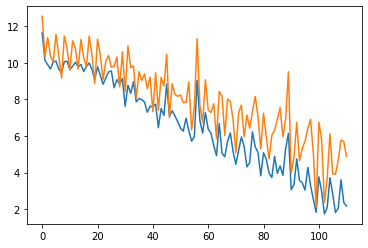

 37%|███▋      | 111/300 [05:22<06:23,  2.03s/it]

nnodes: 10, seq_range 200 epoch: 111


 37%|███▋      | 112/300 [05:26<08:14,  2.63s/it]

loss: 1.384, val_loss 2.367
setting lr to 0.001
nnodes: 1, seq_range 150 epoch: 112


 38%|███▊      | 113/300 [05:27<06:30,  2.09s/it]

loss: 3.360, val_loss 6.618
setting lr to 0.001
nnodes: 2, seq_range 100 epoch: 113


 38%|███▊      | 114/300 [05:28<05:43,  1.85s/it]

loss: 2.337, val_loss 5.901
setting lr to 0.001
nnodes: 5, seq_range 200 epoch: 114


 38%|███▊      | 115/300 [05:30<06:07,  1.99s/it]

loss: 1.203, val_loss 2.140
setting lr to 0.001
nnodes: 10, seq_range 150 epoch: 115


 39%|███▊      | 116/300 [05:34<07:59,  2.60s/it]

loss: 1.294, val_loss 3.181
setting lr to 0.001
nnodes: 1, seq_range 100 epoch: 116


 39%|███▉      | 117/300 [05:35<06:18,  2.07s/it]

loss: 3.082, val_loss 5.736
setting lr to 0.001
nnodes: 2, seq_range 200 epoch: 117


 39%|███▉      | 118/300 [05:36<05:35,  1.84s/it]

loss: 3.192, val_loss 4.572
setting lr to 0.001
nnodes: 5, seq_range 150 epoch: 118


 40%|███▉      | 119/300 [05:39<06:02,  2.00s/it]

loss: 1.738, val_loss 4.290
setting lr to 0.001
nnodes: 10, seq_range 100 epoch: 119


 40%|████      | 120/300 [05:43<08:00,  2.67s/it]

loss: 2.577, val_loss 4.407
setting lr to 0.001
nnodes: 1, seq_range 200 epoch: 120
loss: 3.636, val_loss 6.815
setting lr to 0.001


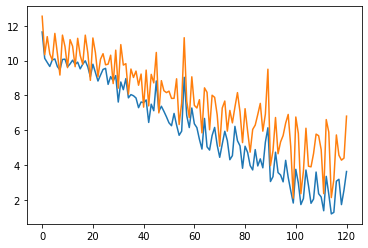

 40%|████      | 121/300 [05:44<06:24,  2.15s/it]

nnodes: 2, seq_range 150 epoch: 121


 41%|████      | 122/300 [05:45<05:36,  1.89s/it]

loss: 1.804, val_loss 5.317
setting lr to 0.001
nnodes: 5, seq_range 100 epoch: 122


 41%|████      | 123/300 [05:47<05:57,  2.02s/it]

loss: 2.367, val_loss 5.688
setting lr to 0.001
nnodes: 10, seq_range 200 epoch: 123


 41%|████▏     | 124/300 [05:51<07:41,  2.62s/it]

loss: 1.160, val_loss 2.559
setting lr to 0.001
nnodes: 1, seq_range 150 epoch: 124


 42%|████▏     | 125/300 [05:52<06:05,  2.09s/it]

loss: 3.058, val_loss 5.954
setting lr to 0.001
nnodes: 2, seq_range 100 epoch: 125


 42%|████▏     | 126/300 [05:54<05:21,  1.85s/it]

loss: 2.021, val_loss 6.159
setting lr to 0.001
nnodes: 5, seq_range 200 epoch: 126


 42%|████▏     | 127/300 [05:56<05:43,  1.98s/it]

loss: 0.924, val_loss 1.722
setting lr to 0.001
nnodes: 10, seq_range 150 epoch: 127


 43%|████▎     | 128/300 [06:00<07:29,  2.62s/it]

loss: 1.040, val_loss 2.758
setting lr to 0.001
nnodes: 1, seq_range 100 epoch: 128


 43%|████▎     | 129/300 [06:01<05:55,  2.08s/it]

loss: 2.976, val_loss 7.607
setting lr to 0.000
nnodes: 2, seq_range 200 epoch: 129


 43%|████▎     | 130/300 [06:02<05:17,  1.87s/it]

loss: 2.132, val_loss 2.939
setting lr to 0.000
nnodes: 5, seq_range 150 epoch: 130
loss: 1.149, val_loss 2.882
setting lr to 0.000


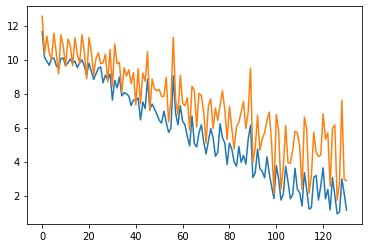

 44%|████▎     | 131/300 [06:05<05:44,  2.04s/it]

nnodes: 10, seq_range 100 epoch: 131


 44%|████▍     | 132/300 [06:09<07:23,  2.64s/it]

loss: 2.655, val_loss 5.784
setting lr to 0.000
nnodes: 1, seq_range 200 epoch: 132


 44%|████▍     | 133/300 [06:09<05:49,  2.09s/it]

loss: 2.970, val_loss 5.426
setting lr to 0.000
nnodes: 2, seq_range 150 epoch: 133


 45%|████▍     | 134/300 [06:11<05:07,  1.85s/it]

loss: 1.405, val_loss 5.338
setting lr to 0.000
nnodes: 5, seq_range 100 epoch: 134


 45%|████▌     | 135/300 [06:13<05:28,  1.99s/it]

loss: 0.995, val_loss 4.339
setting lr to 0.000
nnodes: 10, seq_range 200 epoch: 135


 45%|████▌     | 136/300 [06:17<07:08,  2.61s/it]

loss: 0.576, val_loss 1.237
setting lr to 0.000
nnodes: 1, seq_range 150 epoch: 136


 46%|████▌     | 137/300 [06:18<05:38,  2.08s/it]

loss: 3.039, val_loss 7.992
setting lr to 0.000
nnodes: 2, seq_range 100 epoch: 137


 46%|████▌     | 138/300 [06:19<04:58,  1.84s/it]

loss: 1.757, val_loss 5.361
setting lr to 0.000
nnodes: 5, seq_range 200 epoch: 138


 46%|████▋     | 139/300 [06:22<05:19,  1.98s/it]

loss: 0.610, val_loss 1.322
setting lr to 0.000
nnodes: 10, seq_range 150 epoch: 139


 47%|████▋     | 140/300 [06:26<07:01,  2.64s/it]

loss: 1.107, val_loss 3.602
setting lr to 0.000
nnodes: 1, seq_range 100 epoch: 140
loss: 2.426, val_loss 6.138
setting lr to 0.000


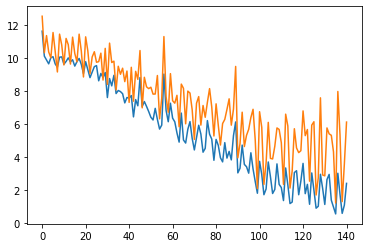

 47%|████▋     | 141/300 [06:27<05:38,  2.13s/it]

nnodes: 2, seq_range 200 epoch: 141


 47%|████▋     | 142/300 [06:28<04:56,  1.88s/it]

loss: 1.518, val_loss 3.238
setting lr to 0.000
nnodes: 5, seq_range 150 epoch: 142


 48%|████▊     | 143/300 [06:30<05:16,  2.01s/it]

loss: 0.639, val_loss 2.422
setting lr to 0.000
nnodes: 10, seq_range 100 epoch: 143


 48%|████▊     | 144/300 [06:34<06:48,  2.62s/it]

loss: 0.827, val_loss 3.235
setting lr to 0.000
nnodes: 1, seq_range 200 epoch: 144


 48%|████▊     | 145/300 [06:35<05:21,  2.08s/it]

loss: 2.462, val_loss 5.575
setting lr to 0.000
nnodes: 2, seq_range 150 epoch: 145


 49%|████▊     | 146/300 [06:36<04:43,  1.84s/it]

loss: 0.914, val_loss 4.688
setting lr to 0.000
nnodes: 5, seq_range 100 epoch: 146


 49%|████▉     | 147/300 [06:39<05:03,  1.98s/it]

loss: 0.674, val_loss 4.632
setting lr to 0.000
nnodes: 10, seq_range 200 epoch: 147


 49%|████▉     | 148/300 [06:43<06:34,  2.60s/it]

loss: 0.107, val_loss 0.783
setting lr to 0.000
nnodes: 1, seq_range 150 epoch: 148


 50%|████▉     | 149/300 [06:44<05:15,  2.09s/it]

loss: 2.019, val_loss 6.582
setting lr to 0.000
nnodes: 2, seq_range 100 epoch: 149


 50%|█████     | 150/300 [06:45<04:37,  1.85s/it]

loss: 1.141, val_loss 5.492
setting lr to 0.000
nnodes: 5, seq_range 200 epoch: 150
loss: 0.173, val_loss 0.988
setting lr to 0.000


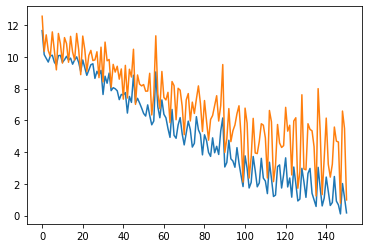

 50%|█████     | 151/300 [06:47<05:03,  2.03s/it]

nnodes: 10, seq_range 150 epoch: 151


 51%|█████     | 152/300 [06:51<06:30,  2.64s/it]

loss: 0.271, val_loss 2.183
setting lr to 0.000
nnodes: 1, seq_range 100 epoch: 152


 51%|█████     | 153/300 [06:52<05:07,  2.09s/it]

loss: 1.987, val_loss 5.965
setting lr to 0.000
nnodes: 2, seq_range 200 epoch: 153


 51%|█████▏    | 154/300 [06:54<04:30,  1.85s/it]

loss: 1.434, val_loss 3.358
setting lr to 0.000
nnodes: 5, seq_range 150 epoch: 154


 52%|█████▏    | 155/300 [06:56<04:48,  1.99s/it]

loss: 0.467, val_loss 2.149
setting lr to 0.000
nnodes: 10, seq_range 100 epoch: 155


 52%|█████▏    | 156/300 [07:00<06:14,  2.60s/it]

loss: 0.732, val_loss 3.441
setting lr to 0.000
nnodes: 1, seq_range 200 epoch: 156


 52%|█████▏    | 157/300 [07:01<04:55,  2.06s/it]

loss: 2.195, val_loss 6.071
setting lr to 0.000
nnodes: 2, seq_range 150 epoch: 157


 53%|█████▎    | 158/300 [07:02<04:19,  1.83s/it]

loss: 0.600, val_loss 4.858
setting lr to 0.000
nnodes: 5, seq_range 100 epoch: 158


 53%|█████▎    | 159/300 [07:04<04:40,  1.99s/it]

loss: 0.435, val_loss 4.666
setting lr to 0.000
nnodes: 10, seq_range 200 epoch: 159


 53%|█████▎    | 160/300 [07:09<06:09,  2.64s/it]

loss: -0.043, val_loss 0.420
setting lr to 0.000
nnodes: 1, seq_range 150 epoch: 160
loss: 1.876, val_loss 6.868
setting lr to 0.000


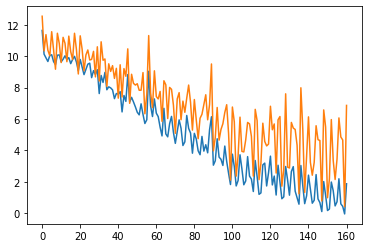

 54%|█████▎    | 161/300 [07:09<04:56,  2.13s/it]

nnodes: 2, seq_range 100 epoch: 161


 54%|█████▍    | 162/300 [07:11<04:19,  1.88s/it]

loss: 0.827, val_loss 5.362
setting lr to 0.000
nnodes: 5, seq_range 200 epoch: 162


 54%|█████▍    | 163/300 [07:13<04:35,  2.01s/it]

loss: -0.074, val_loss 0.850
setting lr to 0.000
nnodes: 10, seq_range 150 epoch: 163


 55%|█████▍    | 164/300 [07:17<05:55,  2.62s/it]

loss: -0.014, val_loss 1.897
setting lr to 0.000
nnodes: 1, seq_range 100 epoch: 164


 55%|█████▌    | 165/300 [07:18<04:40,  2.08s/it]

loss: 1.673, val_loss 6.478
setting lr to 0.000
nnodes: 2, seq_range 200 epoch: 165


 55%|█████▌    | 166/300 [07:19<04:06,  1.84s/it]

loss: 1.124, val_loss 3.129
setting lr to 0.000
nnodes: 5, seq_range 150 epoch: 166


 56%|█████▌    | 167/300 [07:22<04:23,  1.98s/it]

loss: 0.109, val_loss 1.824
setting lr to 0.000
nnodes: 10, seq_range 100 epoch: 167


 56%|█████▌    | 168/300 [07:26<05:47,  2.63s/it]

loss: 0.491, val_loss 3.545
setting lr to 0.000
nnodes: 1, seq_range 200 epoch: 168


 56%|█████▋    | 169/300 [07:27<04:33,  2.09s/it]

loss: 1.852, val_loss 5.692
setting lr to 0.000
nnodes: 2, seq_range 150 epoch: 169


 57%|█████▋    | 170/300 [07:28<03:59,  1.85s/it]

loss: 0.537, val_loss 5.663
setting lr to 0.000
nnodes: 5, seq_range 100 epoch: 170
loss: 0.292, val_loss 4.426
setting lr to 0.000


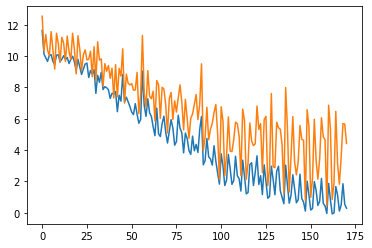

 57%|█████▋    | 171/300 [07:30<04:21,  2.02s/it]

nnodes: 10, seq_range 200 epoch: 171


 57%|█████▋    | 172/300 [07:34<05:35,  2.62s/it]

loss: -0.246, val_loss 0.412
setting lr to 0.000
nnodes: 1, seq_range 150 epoch: 172


 58%|█████▊    | 173/300 [07:35<04:24,  2.08s/it]

loss: 1.646, val_loss 6.608
setting lr to 0.000
nnodes: 2, seq_range 100 epoch: 173


 58%|█████▊    | 174/300 [07:36<03:52,  1.84s/it]

loss: 0.652, val_loss 5.898
setting lr to 0.000
nnodes: 5, seq_range 200 epoch: 174


 58%|█████▊    | 175/300 [07:39<04:07,  1.98s/it]

loss: -0.141, val_loss 1.123
setting lr to 0.000
nnodes: 10, seq_range 150 epoch: 175


 59%|█████▊    | 176/300 [07:43<05:21,  2.60s/it]

loss: -0.159, val_loss 1.584
setting lr to 0.000
nnodes: 1, seq_range 100 epoch: 176


 59%|█████▉    | 177/300 [07:44<04:13,  2.06s/it]

loss: 1.428, val_loss 6.870
setting lr to 0.000
nnodes: 2, seq_range 200 epoch: 177


 59%|█████▉    | 178/300 [07:45<03:44,  1.84s/it]

loss: 0.902, val_loss 2.980
setting lr to 0.000
nnodes: 5, seq_range 150 epoch: 178


 60%|█████▉    | 179/300 [07:47<04:05,  2.03s/it]

loss: -0.077, val_loss 1.716
setting lr to 0.000
nnodes: 10, seq_range 100 epoch: 179


 60%|██████    | 180/300 [07:51<05:16,  2.64s/it]

loss: 0.363, val_loss 3.598
setting lr to 0.000
nnodes: 1, seq_range 200 epoch: 180
loss: 1.766, val_loss 5.507
setting lr to 0.000


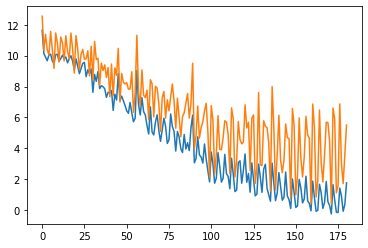

 60%|██████    | 181/300 [07:52<04:13,  2.13s/it]

nnodes: 2, seq_range 150 epoch: 181


 61%|██████    | 182/300 [07:54<03:41,  1.88s/it]

loss: 0.634, val_loss 6.279
setting lr to 0.000
nnodes: 5, seq_range 100 epoch: 182


 61%|██████    | 183/300 [07:56<03:54,  2.01s/it]

loss: 0.256, val_loss 4.393
setting lr to 0.000
nnodes: 10, seq_range 200 epoch: 183


 61%|██████▏   | 184/300 [08:00<05:04,  2.63s/it]

loss: -0.295, val_loss 1.058
setting lr to 0.000
nnodes: 1, seq_range 150 epoch: 184


 62%|██████▏   | 185/300 [08:01<03:59,  2.09s/it]

loss: 1.427, val_loss 6.453
setting lr to 0.000
nnodes: 2, seq_range 100 epoch: 185


 62%|██████▏   | 186/300 [08:02<03:30,  1.85s/it]

loss: 0.553, val_loss 6.439
setting lr to 0.000
nnodes: 5, seq_range 200 epoch: 186


 62%|██████▏   | 187/300 [08:04<03:44,  1.99s/it]

loss: -0.345, val_loss 1.039
setting lr to 0.000
nnodes: 10, seq_range 150 epoch: 187


 63%|██████▎   | 188/300 [08:09<04:57,  2.66s/it]

loss: -0.322, val_loss 1.599
setting lr to 0.000
nnodes: 1, seq_range 100 epoch: 188


 63%|██████▎   | 189/300 [08:09<03:55,  2.13s/it]

loss: 1.220, val_loss 7.026
setting lr to 0.000
nnodes: 2, seq_range 200 epoch: 189


 63%|██████▎   | 190/300 [08:11<03:34,  1.95s/it]

loss: 0.487, val_loss 2.521
setting lr to 0.000
nnodes: 5, seq_range 150 epoch: 190
loss: -0.375, val_loss 1.904
setting lr to 0.000


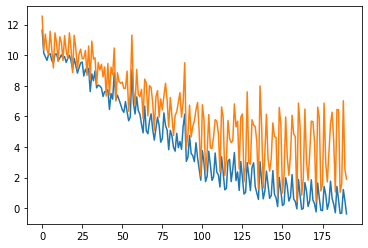

 64%|██████▎   | 191/300 [08:14<03:56,  2.17s/it]

nnodes: 10, seq_range 100 epoch: 191


 64%|██████▍   | 192/300 [08:18<05:02,  2.80s/it]

loss: 0.022, val_loss 3.132
setting lr to 0.000
nnodes: 1, seq_range 200 epoch: 192


 64%|██████▍   | 193/300 [08:19<04:00,  2.24s/it]

loss: 1.538, val_loss 5.438
setting lr to 0.000
nnodes: 2, seq_range 150 epoch: 193


 65%|██████▍   | 194/300 [08:20<03:28,  1.96s/it]

loss: 0.430, val_loss 6.489
setting lr to 0.000
nnodes: 5, seq_range 100 epoch: 194


 65%|██████▌   | 195/300 [08:23<03:40,  2.10s/it]

loss: 0.082, val_loss 4.440
setting lr to 0.000
nnodes: 10, seq_range 200 epoch: 195


 65%|██████▌   | 196/300 [08:27<04:39,  2.68s/it]

loss: -0.486, val_loss 0.823
setting lr to 0.000
nnodes: 1, seq_range 150 epoch: 196


 66%|██████▌   | 197/300 [08:28<03:41,  2.16s/it]

loss: 1.276, val_loss 6.322
setting lr to 0.000
nnodes: 2, seq_range 100 epoch: 197


 66%|██████▌   | 198/300 [08:29<03:13,  1.90s/it]

loss: 0.413, val_loss 6.314
setting lr to 0.000
nnodes: 5, seq_range 200 epoch: 198


 66%|██████▋   | 199/300 [08:31<03:24,  2.03s/it]

loss: -0.502, val_loss 0.742
setting lr to 0.000
nnodes: 10, seq_range 150 epoch: 199


 67%|██████▋   | 200/300 [08:35<04:23,  2.63s/it]

loss: -0.458, val_loss 1.934
setting lr to 0.000
nnodes: 1, seq_range 100 epoch: 200
loss: 1.058, val_loss 6.884
setting lr to 0.000


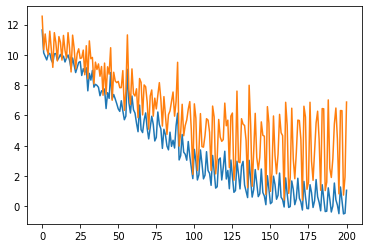

 67%|██████▋   | 201/300 [08:36<03:31,  2.13s/it]

nnodes: 2, seq_range 200 epoch: 201


 67%|██████▋   | 202/300 [08:38<03:04,  1.88s/it]

loss: 0.369, val_loss 2.527
setting lr to 0.000
nnodes: 5, seq_range 150 epoch: 202


 68%|██████▊   | 203/300 [08:40<03:15,  2.01s/it]

loss: -0.516, val_loss 1.860
setting lr to 0.000
nnodes: 10, seq_range 100 epoch: 203


 68%|██████▊   | 204/300 [08:44<04:11,  2.62s/it]

loss: -0.147, val_loss 3.103
setting lr to 0.000
nnodes: 1, seq_range 200 epoch: 204


 68%|██████▊   | 205/300 [08:45<03:17,  2.08s/it]

loss: 1.268, val_loss 5.608
setting lr to 0.000
nnodes: 2, seq_range 150 epoch: 205


 69%|██████▊   | 206/300 [08:46<02:53,  1.85s/it]

loss: -0.017, val_loss 5.661
setting lr to 0.000
nnodes: 5, seq_range 100 epoch: 206


 69%|██████▉   | 207/300 [08:48<03:06,  2.00s/it]

loss: -0.208, val_loss 4.452
setting lr to 0.000
nnodes: 10, seq_range 200 epoch: 207


 69%|██████▉   | 208/300 [08:53<04:06,  2.68s/it]

loss: -0.772, val_loss 0.363
setting lr to 0.000
nnodes: 1, seq_range 150 epoch: 208


 70%|██████▉   | 209/300 [08:54<03:13,  2.12s/it]

loss: 1.015, val_loss 6.222
setting lr to 0.000
nnodes: 2, seq_range 100 epoch: 209


 70%|███████   | 210/300 [08:55<02:49,  1.88s/it]

loss: 0.160, val_loss 5.950
setting lr to 0.000
nnodes: 5, seq_range 200 epoch: 210
loss: -0.674, val_loss 0.674
setting lr to 0.000


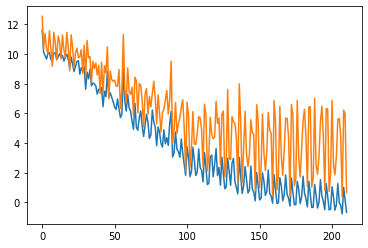

 70%|███████   | 211/300 [08:57<03:02,  2.05s/it]

nnodes: 10, seq_range 150 epoch: 211


 71%|███████   | 212/300 [09:01<03:53,  2.65s/it]

loss: -0.633, val_loss 1.799
setting lr to 0.000
nnodes: 1, seq_range 100 epoch: 212


 71%|███████   | 213/300 [09:02<03:03,  2.11s/it]

loss: 0.903, val_loss 6.971
setting lr to 0.000
nnodes: 2, seq_range 200 epoch: 213


 71%|███████▏  | 214/300 [09:03<02:40,  1.86s/it]

loss: 0.236, val_loss 2.183
setting lr to 0.000
nnodes: 5, seq_range 150 epoch: 214


 72%|███████▏  | 215/300 [09:06<02:50,  2.00s/it]

loss: -0.643, val_loss 2.072
setting lr to 0.000
nnodes: 10, seq_range 100 epoch: 215


 72%|███████▏  | 216/300 [09:10<03:40,  2.62s/it]

loss: -0.328, val_loss 2.904
setting lr to 0.000
nnodes: 1, seq_range 200 epoch: 216


 72%|███████▏  | 217/300 [09:11<02:55,  2.11s/it]

loss: 1.115, val_loss 5.983
setting lr to 0.000
nnodes: 2, seq_range 150 epoch: 217


 73%|███████▎  | 218/300 [09:12<02:32,  1.86s/it]

loss: -0.205, val_loss 5.052
setting lr to 0.000
nnodes: 5, seq_range 100 epoch: 218


 73%|███████▎  | 219/300 [09:14<02:42,  2.00s/it]

loss: -0.389, val_loss 4.330
setting lr to 0.000
nnodes: 10, seq_range 200 epoch: 219


 73%|███████▎  | 220/300 [09:18<03:29,  2.61s/it]

loss: -0.924, val_loss -0.040
setting lr to 0.000
nnodes: 1, seq_range 150 epoch: 220
loss: 0.907, val_loss 6.556
setting lr to 0.000


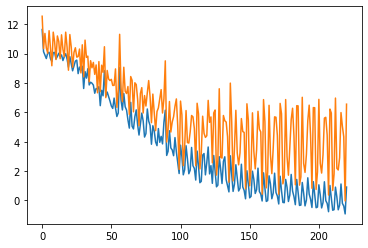

 74%|███████▎  | 221/300 [09:19<02:47,  2.12s/it]

nnodes: 2, seq_range 100 epoch: 221


 74%|███████▍  | 222/300 [09:21<02:25,  1.87s/it]

loss: 0.020, val_loss 6.267
setting lr to 0.000
nnodes: 5, seq_range 200 epoch: 222


 74%|███████▍  | 223/300 [09:23<02:34,  2.00s/it]

loss: -0.720, val_loss 0.783
setting lr to 0.000
nnodes: 10, seq_range 150 epoch: 223


 75%|███████▍  | 224/300 [09:27<03:19,  2.62s/it]

loss: -0.767, val_loss 1.587
setting lr to 0.000
nnodes: 1, seq_range 100 epoch: 224


 75%|███████▌  | 225/300 [09:28<02:36,  2.08s/it]

loss: 0.751, val_loss 6.921
setting lr to 0.000
nnodes: 2, seq_range 200 epoch: 225


 75%|███████▌  | 226/300 [09:29<02:16,  1.85s/it]

loss: 0.130, val_loss 2.043
setting lr to 0.000
nnodes: 5, seq_range 150 epoch: 226


 76%|███████▌  | 227/300 [09:31<02:25,  1.99s/it]

loss: -0.728, val_loss 2.214
setting lr to 0.000
nnodes: 10, seq_range 100 epoch: 227


 76%|███████▌  | 228/300 [09:36<03:10,  2.65s/it]

loss: -0.433, val_loss 2.864
setting lr to 0.000
nnodes: 1, seq_range 200 epoch: 228


 76%|███████▋  | 229/300 [09:37<02:29,  2.10s/it]

loss: 0.961, val_loss 5.995
setting lr to 0.000
nnodes: 2, seq_range 150 epoch: 229


 77%|███████▋  | 230/300 [09:38<02:10,  1.87s/it]

loss: -0.341, val_loss 4.764
setting lr to 0.000
nnodes: 5, seq_range 100 epoch: 230
loss: -0.512, val_loss 4.269
setting lr to 0.000


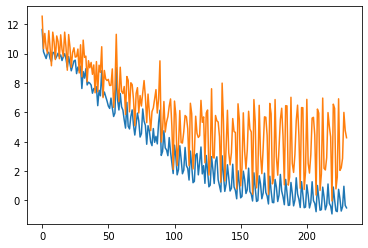

 77%|███████▋  | 231/300 [09:40<02:21,  2.04s/it]

nnodes: 10, seq_range 200 epoch: 231


 77%|███████▋  | 232/300 [09:44<02:59,  2.64s/it]

loss: -1.023, val_loss -0.222
setting lr to 0.000
nnodes: 1, seq_range 150 epoch: 232


 78%|███████▊  | 233/300 [09:45<02:20,  2.10s/it]

loss: 0.765, val_loss 6.640
setting lr to 0.000
nnodes: 2, seq_range 100 epoch: 233


 78%|███████▊  | 234/300 [09:46<02:02,  1.86s/it]

loss: -0.108, val_loss 6.552
setting lr to 0.000
nnodes: 5, seq_range 200 epoch: 234


 78%|███████▊  | 235/300 [09:49<02:10,  2.00s/it]

loss: -0.830, val_loss 0.725
setting lr to 0.000
nnodes: 10, seq_range 150 epoch: 235


 79%|███████▊  | 236/300 [09:53<02:49,  2.64s/it]

loss: -0.862, val_loss 1.710
setting lr to 0.000
nnodes: 1, seq_range 100 epoch: 236


 79%|███████▉  | 237/300 [09:54<02:12,  2.10s/it]

loss: 0.647, val_loss 6.720
setting lr to 0.000
nnodes: 2, seq_range 200 epoch: 237


 79%|███████▉  | 238/300 [09:55<01:55,  1.86s/it]

loss: 0.054, val_loss 2.200
setting lr to 0.000
nnodes: 5, seq_range 150 epoch: 238


 80%|███████▉  | 239/300 [09:57<02:02,  2.00s/it]

loss: -0.864, val_loss 1.945
setting lr to 0.000
nnodes: 10, seq_range 100 epoch: 239


 80%|████████  | 240/300 [10:02<02:39,  2.65s/it]

loss: -0.532, val_loss 2.737
setting lr to 0.000
nnodes: 1, seq_range 200 epoch: 240
loss: 0.864, val_loss 6.013
setting lr to 0.000


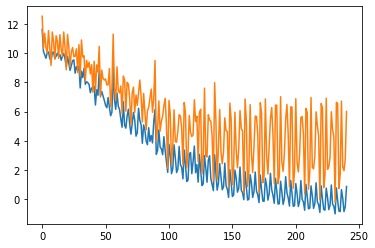

 80%|████████  | 241/300 [10:03<02:06,  2.15s/it]

nnodes: 2, seq_range 150 epoch: 241


 81%|████████  | 242/300 [10:04<01:49,  1.89s/it]

loss: -0.432, val_loss 5.075
setting lr to 0.000
nnodes: 5, seq_range 100 epoch: 242


 81%|████████  | 243/300 [10:06<01:55,  2.02s/it]

loss: -0.619, val_loss 4.224
setting lr to 0.000
nnodes: 10, seq_range 200 epoch: 243


 81%|████████▏ | 244/300 [10:10<02:27,  2.63s/it]

loss: -1.116, val_loss -0.311
setting lr to 0.000
nnodes: 1, seq_range 150 epoch: 244


 82%|████████▏ | 245/300 [10:11<01:54,  2.09s/it]

loss: 0.629, val_loss 6.813
setting lr to 0.000
nnodes: 2, seq_range 100 epoch: 245


 82%|████████▏ | 246/300 [10:12<01:40,  1.85s/it]

loss: -0.194, val_loss 6.723
setting lr to 0.000
nnodes: 5, seq_range 200 epoch: 246


 82%|████████▏ | 247/300 [10:15<01:46,  2.00s/it]

loss: -0.942, val_loss 0.539
setting lr to 0.000
nnodes: 10, seq_range 150 epoch: 247


 83%|████████▎ | 248/300 [10:19<02:19,  2.67s/it]

loss: -0.945, val_loss 1.860
setting lr to 0.000
nnodes: 1, seq_range 100 epoch: 248


 83%|████████▎ | 249/300 [10:20<01:48,  2.12s/it]

loss: 0.593, val_loss 6.623
setting lr to 0.000
nnodes: 2, seq_range 200 epoch: 249


 83%|████████▎ | 250/300 [10:21<01:33,  1.88s/it]

loss: 0.009, val_loss 2.352
setting lr to 0.000
nnodes: 5, seq_range 150 epoch: 250
loss: -0.975, val_loss 1.806
setting lr to 0.000


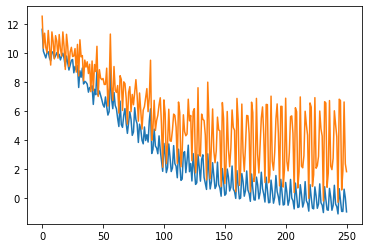

 84%|████████▎ | 251/300 [10:24<01:40,  2.05s/it]

nnodes: 10, seq_range 100 epoch: 251


 84%|████████▍ | 252/300 [10:28<02:07,  2.65s/it]

loss: -0.573, val_loss 2.723
setting lr to 0.000
nnodes: 1, seq_range 200 epoch: 252


 84%|████████▍ | 253/300 [10:28<01:39,  2.11s/it]

loss: 0.814, val_loss 6.007
setting lr to 0.000
nnodes: 2, seq_range 150 epoch: 253


 85%|████████▍ | 254/300 [10:30<01:25,  1.86s/it]

loss: -0.509, val_loss 5.141
setting lr to 0.000
nnodes: 5, seq_range 100 epoch: 254


 85%|████████▌ | 255/300 [10:32<01:30,  2.01s/it]

loss: -0.696, val_loss 4.234
setting lr to 0.000
nnodes: 10, seq_range 200 epoch: 255


 85%|████████▌ | 256/300 [10:36<01:56,  2.65s/it]

loss: -1.169, val_loss -0.455
setting lr to 0.000
nnodes: 1, seq_range 150 epoch: 256


 86%|████████▌ | 257/300 [10:37<01:30,  2.11s/it]

loss: 0.550, val_loss 6.921
setting lr to 0.000
nnodes: 2, seq_range 100 epoch: 257


 86%|████████▌ | 258/300 [10:38<01:18,  1.87s/it]

loss: -0.258, val_loss 6.850
setting lr to 0.000
nnodes: 5, seq_range 200 epoch: 258


 86%|████████▋ | 259/300 [10:41<01:22,  2.00s/it]

loss: -1.012, val_loss 0.429
setting lr to 0.000
nnodes: 10, seq_range 150 epoch: 259


 87%|████████▋ | 260/300 [10:45<01:44,  2.62s/it]

loss: -1.009, val_loss 1.905
setting lr to 0.000
nnodes: 1, seq_range 100 epoch: 260
loss: 0.522, val_loss 6.607
setting lr to 0.000


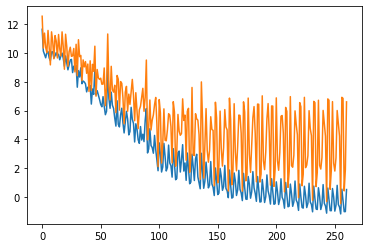

 87%|████████▋ | 261/300 [10:46<01:22,  2.12s/it]

nnodes: 2, seq_range 200 epoch: 261


 87%|████████▋ | 262/300 [10:47<01:11,  1.88s/it]

loss: -0.071, val_loss 2.338
setting lr to 0.000
nnodes: 5, seq_range 150 epoch: 262


 88%|████████▊ | 263/300 [10:49<01:14,  2.02s/it]

loss: -1.043, val_loss 1.827
setting lr to 0.000
nnodes: 10, seq_range 100 epoch: 263


 88%|████████▊ | 264/300 [10:53<01:34,  2.63s/it]

loss: -0.620, val_loss 2.769
setting lr to 0.000
nnodes: 1, seq_range 200 epoch: 264


 88%|████████▊ | 265/300 [10:54<01:12,  2.09s/it]

loss: 0.734, val_loss 6.099
setting lr to 0.000
nnodes: 2, seq_range 150 epoch: 265


 89%|████████▊ | 266/300 [10:56<01:02,  1.85s/it]

loss: -0.584, val_loss 5.125
setting lr to 0.000
nnodes: 5, seq_range 100 epoch: 266


 89%|████████▉ | 267/300 [10:58<01:05,  1.99s/it]

loss: -0.743, val_loss 4.226
setting lr to 0.000
nnodes: 10, seq_range 200 epoch: 267


 89%|████████▉ | 268/300 [11:02<01:24,  2.64s/it]

loss: -1.178, val_loss -0.423
setting lr to 0.000
nnodes: 1, seq_range 150 epoch: 268


 90%|████████▉ | 269/300 [11:03<01:05,  2.10s/it]

loss: 0.495, val_loss 7.279
setting lr to 0.000
nnodes: 2, seq_range 100 epoch: 269


 90%|█████████ | 270/300 [11:04<00:55,  1.86s/it]

loss: -0.315, val_loss 6.974
setting lr to 0.000
nnodes: 5, seq_range 200 epoch: 270
loss: -1.069, val_loss 0.383
setting lr to 0.000


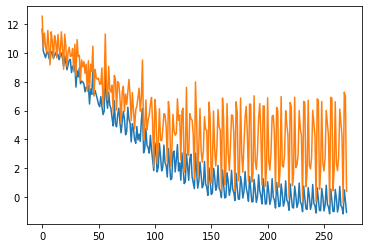

 90%|█████████ | 271/300 [11:07<00:59,  2.04s/it]

nnodes: 10, seq_range 150 epoch: 271


 91%|█████████ | 272/300 [11:11<01:14,  2.65s/it]

loss: -1.032, val_loss 2.031
setting lr to 0.000
nnodes: 1, seq_range 100 epoch: 272


 91%|█████████ | 273/300 [11:11<00:56,  2.11s/it]

loss: 0.485, val_loss 6.673
setting lr to 0.000
nnodes: 2, seq_range 200 epoch: 273


 91%|█████████▏| 274/300 [11:13<00:48,  1.86s/it]

loss: -0.154, val_loss 2.185
setting lr to 0.000
nnodes: 5, seq_range 150 epoch: 274


 92%|█████████▏| 275/300 [11:15<00:49,  2.00s/it]

loss: -1.098, val_loss 1.824
setting lr to 0.000
nnodes: 10, seq_range 100 epoch: 275


 92%|█████████▏| 276/300 [11:19<01:03,  2.64s/it]

loss: -0.671, val_loss 2.834
setting lr to 0.000
nnodes: 1, seq_range 200 epoch: 276


 92%|█████████▏| 277/300 [11:20<00:48,  2.10s/it]

loss: 0.657, val_loss 6.056
setting lr to 0.000
nnodes: 2, seq_range 150 epoch: 277


 93%|█████████▎| 278/300 [11:21<00:40,  1.86s/it]

loss: -0.688, val_loss 5.036
setting lr to 0.000
nnodes: 5, seq_range 100 epoch: 278


 93%|█████████▎| 279/300 [11:24<00:42,  2.01s/it]

loss: -0.798, val_loss 4.276
setting lr to 0.000
nnodes: 10, seq_range 200 epoch: 279


 93%|█████████▎| 280/300 [11:28<00:52,  2.62s/it]

loss: -1.197, val_loss -0.356
setting lr to 0.000
nnodes: 1, seq_range 150 epoch: 280
loss: 0.446, val_loss 7.452
setting lr to 0.000


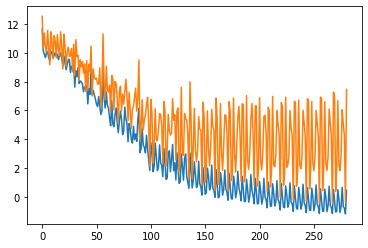

 94%|█████████▎| 281/300 [11:29<00:40,  2.12s/it]

nnodes: 2, seq_range 100 epoch: 281


 94%|█████████▍| 282/300 [11:30<00:33,  1.88s/it]

loss: -0.383, val_loss 6.758
setting lr to 0.000
nnodes: 5, seq_range 200 epoch: 282


 94%|█████████▍| 283/300 [11:32<00:34,  2.01s/it]

loss: -1.071, val_loss 0.310
setting lr to 0.000
nnodes: 10, seq_range 150 epoch: 283


 95%|█████████▍| 284/300 [11:36<00:41,  2.62s/it]

loss: -1.050, val_loss 2.158
setting lr to 0.000
nnodes: 1, seq_range 100 epoch: 284


 95%|█████████▌| 285/300 [11:37<00:31,  2.08s/it]

loss: 0.439, val_loss 6.777
setting lr to 0.000
nnodes: 2, seq_range 200 epoch: 285


 95%|█████████▌| 286/300 [11:39<00:25,  1.85s/it]

loss: -0.257, val_loss 1.833
setting lr to 0.000
nnodes: 5, seq_range 150 epoch: 286


 96%|█████████▌| 287/300 [11:41<00:26,  2.02s/it]

loss: -1.121, val_loss 1.840
setting lr to 0.000
nnodes: 10, seq_range 100 epoch: 287


 96%|█████████▌| 288/300 [11:45<00:31,  2.63s/it]

loss: -0.731, val_loss 2.896
setting lr to 0.000
nnodes: 1, seq_range 200 epoch: 288


 96%|█████████▋| 289/300 [11:46<00:22,  2.09s/it]

loss: 0.591, val_loss 6.054
setting lr to 0.000
nnodes: 2, seq_range 150 epoch: 289


 97%|█████████▋| 290/300 [11:47<00:18,  1.85s/it]

loss: -0.763, val_loss 4.978
setting lr to 0.000
nnodes: 5, seq_range 100 epoch: 290
loss: -0.853, val_loss 4.251
setting lr to 0.000


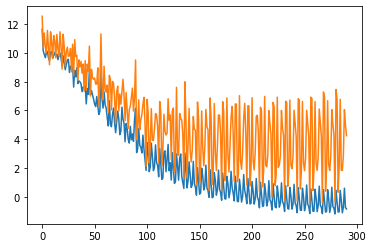

 97%|█████████▋| 291/300 [11:50<00:18,  2.04s/it]

nnodes: 10, seq_range 200 epoch: 291


 97%|█████████▋| 292/300 [11:54<00:21,  2.64s/it]

loss: -1.239, val_loss -0.283
setting lr to 0.000
nnodes: 1, seq_range 150 epoch: 292


 98%|█████████▊| 293/300 [11:54<00:14,  2.10s/it]

loss: 0.345, val_loss 7.556
setting lr to 0.000
nnodes: 2, seq_range 100 epoch: 293


 98%|█████████▊| 294/300 [11:56<00:11,  1.86s/it]

loss: -0.462, val_loss 6.393
setting lr to 0.000
nnodes: 5, seq_range 200 epoch: 294


 98%|█████████▊| 295/300 [11:58<00:10,  2.00s/it]

loss: -1.049, val_loss 0.301
setting lr to 0.000
nnodes: 10, seq_range 150 epoch: 295


 99%|█████████▊| 296/300 [12:02<00:10,  2.67s/it]

loss: -1.126, val_loss 2.138
setting lr to 0.000
nnodes: 1, seq_range 100 epoch: 296


 99%|█████████▉| 297/300 [12:03<00:06,  2.12s/it]

loss: 0.353, val_loss 6.881
setting lr to 0.000
nnodes: 2, seq_range 200 epoch: 297


 99%|█████████▉| 298/300 [12:04<00:03,  1.88s/it]

loss: -0.339, val_loss 1.385
setting lr to 0.000
nnodes: 5, seq_range 150 epoch: 298


100%|█████████▉| 299/300 [12:07<00:02,  2.01s/it]

loss: -1.129, val_loss 1.852
setting lr to 0.000
nnodes: 10, seq_range 100 epoch: 299


100%|██████████| 300/300 [12:11<00:00,  2.44s/it]

loss: -0.799, val_loss 2.895
setting lr to 0.000


In [44]:
n_epochs = 300
nbatch  = 100


val_pct = 0.1
fixed_spacing_indices = False;
nnodes_schedule =     [1,2,5,10] #[10,10,1,2,5]#2,2,3,3]#,1,2,2,1,1,3,3]
nseq_range_schedule = [200,150,100];
min_spacing_schedule =[10];
iterations_schedule = [5]
eval_mode= "batched"
#eval_mode= "safe"

#nnodes_schedule = [1,2,4,4,5,10,5]
#nseq_range_schedule = [2,5,15,15,20,50,30]
#min_spacing_schedule = [1,1,1,1,1,1]
#iterations_schedule =  [3,2,3,3,4]

#nnodes_schedule = [1,2,5]
#nseq_range_schedule = [20]
#min_spacing_schedule = [1,1,1]
#iterations_schedule = [3,3,3]

for i in tqdm(range(n_epochs)):
    np.random.seed(42); 
    epoch = i
    
    # This makes sure that I always get different training and validation sets (there can still be some overlap but training should work ok)
    nnodes      = nnodes_schedule[i%len(nnodes_schedule)]
    nseq_range  = nseq_range_schedule[i%len(nseq_range_schedule)]
    min_spacing = min_spacing_schedule[i%len(min_spacing_schedule)]
    iterations = iterations_schedule[i%len(iterations_schedule)]
    
    if (nnodes * min_spacing) > nseq_range:
        min_spacing = 10
        nseq_range = nnodes * min_spacing+10
        
    print("nnodes: %i, seq_range %i epoch: %i"%(nnodes, nseq_range, i))
    curr_data = get_multi_batch_femto(nbatch, source_ds=True,nnodes=nnodes,
                                min_spacing = min_spacing,
                                nseq_range = nseq_range,
                                fixed_spacing_indices=fixed_spacing_indices);
    
    loss_epoch = 0;
    val_loss_epoch = 0;
    
    for single_minibatch in curr_data:
        with tf.GradientTape() as tape:
            graph_curr, y_curr = single_minibatch;
            #print(graph_curr)
            #def eval_graphnets_loss(graph_curr_, ycurr_,iterations):
            prob_out = gn_tot.eval_graphnets(graph_curr.copy(), iterations, eval_mode=eval_mode)
            loss_vals = -prob_out.log_prob(y_curr[np.newaxis].T)
            #ycurr_t = y_curr[np.newaxis].T
            #ycurr_t = tf.Variable(ycurr_t)
            #loss_vals=  eval_graphnets_loss(graph_curr.copy(), ycurr_t, tf.constant(iterations))
            
            all_weights =gn_tot.weights() 
            
            
            train_loss = loss_vals[0:int(nbatch*(1-val_pct))];
            
            grads = tape.gradient(train_loss, all_weights)
            all_weights_filt = [all_weights[k] for k in range(len(grads)) if grads[k] is not None]
            grads_filt = [grads[k] for k in range(len(grads)) if grads[k] is not None]
            opt.apply_gradients(zip(grads_filt, all_weights_filt))
            loss_epoch += train_loss/len(y_curr)
        
        val_loss_epoch += tf.reduce_mean(loss_vals[int(-nbatch*(val_pct)):])
        
    loss_log.append_loss(np.sum(loss_epoch.numpy()))
    loss_log.append_val_loss(np.sum(val_loss_epoch.numpy()))
    loss_log.print()
    lr_scheduler.on_epoch_end(epoch)
    if early_stop.on_epoch_end(epoch):
        break
        
    if epoch%10 == 0:
        pplot.plot(loss_log.loss_history['loss'])
        pplot.plot(loss_log.loss_history['val_loss'])
        pplot.show()
        

## Improving evaluation and training performance with batching
The initial implementation was not attempting to have multiple edges and nodes evaluated at the same time.
By parallelizing that, for the current architecture (networks with causal connectivity) it was found that even for relatively few vertices there is a two-fold improvement in performance. 

| nodes in graph  | safe | batched |
|----|-----------|--------|
|5  | 4.10s/it |3.5s/it |
|10 | 11.85s/it |5.2s/it |

next step to improve performance is supporting compilation (`@tf.function` decorator) and for improved usability it may be a good idea to implement something like the graph tuple of deepmind's graphnet implementation.

In [193]:

def graphnet_latent_states(graph_data_, iterations = 2):
    graph_out_tmp = gn_tot.graph_indep.graph_eval(graph_data_)
    lat_states = [graph_out_tmp]
    for iterations in range(iterations):
        graph_out_tmp = gn_tot.core.graph_eval(graph_out_tmp) + graph_out_tmp
        lat_states.append(graph_out_tmp)
    return lat_states

# curr_data = get_multi_batch(2, source_ds=True,nnodes=5,
#                             min_spacing = 20,
#                             nseq_range = 100,
#                             fixed_spacing_indices=True);
# c = curr_data[0][0]


# for c in curr_data:
#     c = c[0]
#     c = graphnet_latent_states(c.copy(), iterations =5)
#     pplot.figure(figsize = (10,5)) 
#     pplot.subplot(1,2,1)
#     pplot.pcolor(np.vstack([c_.nodes[-1].node_attr_tensor.numpy() for c_ in c]).T)
#     pplot.subplot(1,2,2)
#     pplot.pcolor(np.vstack([c_.nodes[0].node_attr_tensor.numpy() for c_ in c]).T)
#     pplot.show()
    

Text(0.5, 1.0, 'Loss curves\nBearings dataset')

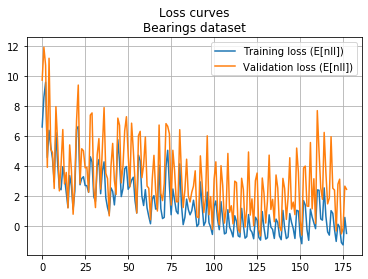

In [194]:
#pplot.figure(dpi - )
pplot.plot(loss_log.loss_history['loss'],label = 'Training loss (E[nll])')
pplot.plot(loss_log.loss_history['val_loss'],label = 'Validation loss (E[nll])')
pplot.legend()
pplot.grid()
pplot.title("Loss curves\nBearings dataset")
#pplot.savefig("/home/charilaos/current/paper/figures/losscurves_bearings.pdf")


Text(0.5, 1.0, 'Loss curves\nBearings dataset')

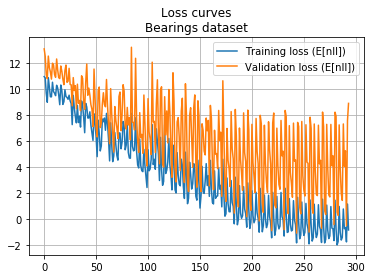

In [96]:
#pplot.figure(dpi - )
pplot.plot(loss_log.loss_history['loss'],label = 'Training loss (E[nll])')
pplot.plot(loss_log.loss_history['val_loss'],label = 'Validation loss (E[nll])')
pplot.legend()
pplot.grid()
pplot.title("Loss curves\nBearings dataset")


2


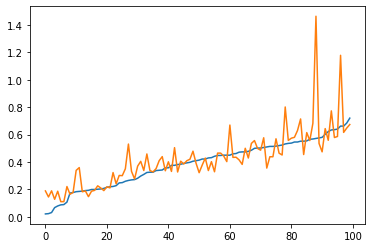

In [195]:
#loss_vals = -prob_out.log_prob(y_curr[np.newaxis].T)
#loss_vals
print(nnodes)
prob_out = gn_tot.eval_graphnets(graph_curr.copy(), iterations)

ids_sort = np.argsort(y_curr);
pplot.plot(y_curr[ids_sort])
pplot.plot(prob_out.mean().numpy().flatten()[ids_sort])

In [196]:
inds_exp_target

[0, 5, 6, 8, 9, 10, 12, 13, 14]

In [197]:
# Inspect the learned embeddings for different experiments. See if some of them cluster.
def get_exp_dat(exp_num, keep_from_end, skip = 5):
    ids = np.argmax(femto_dataset.eid_oh,1) == exp_num
    
    return femto_dataset.X[ids][-keep_from_end::skip,:,:],femto_dataset.yrem_norm[ids][-keep_from_end::skip]
#embs = graph_indep.node_function(get_exp_dat(1))
#graph_indep.node_function.summary()

keep_from_end = 200;
all_embs = []
exp_inds_plot = []
yfrom_ends = []
for ee in [*inds_exp_source, *inds_exp_target]:
    g, gg = get_exp_dat(ee, keep_from_end)
    
    e = gn_tot.graph_indep.node_function([np.zeros([g.shape[0],1]).astype("float32") ,g])
    all_embs.append(e)
    exp_inds_plot.append([ee]*len(g))
    yfrom_ends.append(gg)
    
    
exp_inds_plot = np.hstack(exp_inds_plot)
yfrom_ends = np.hstack(yfrom_ends)
#graph_indep.node_function.inputs

#graph_indep.node_function()


In [198]:
istarget = np.zeros_like(exp_inds_plot)
istarget[[e_ for e_,e in enumerate(exp_inds_plot) if e in inds_exp_target]] = 1


In [199]:
all_embs_ = np.vstack([a.numpy() for a in all_embs])
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
pca = PCA(n_components=4);
tsne = TSNE(n_components=2);
tsne= tsne.fit_transform(all_embs_)
#pplot.scatter(epca[:,0],epca[:,1])


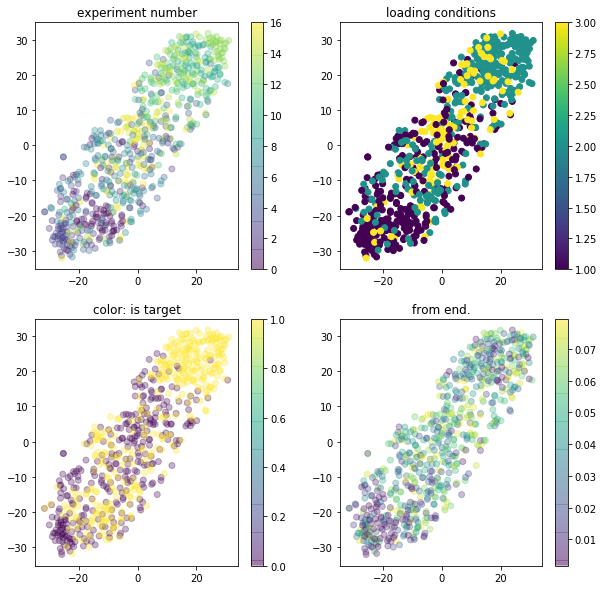

In [200]:
pplot.figure(figsize = (10,10))
pplot.subplot(2,2,1)
pplot.scatter(tsne[:,0], tsne[:,1],c = exp_inds_plot, alpha = 0.3)
pplot.title("experiment number")
pplot.colorbar()
pplot.subplot(2,2,2)
pplot.scatter(tsne[:,0], tsne[:,1],c = [femto_dataset.exp_to_cond_dict[k] for k in exp_inds_plot])
pplot.title("loading conditions")
pplot.colorbar()
pplot.subplot(2,2,3)
pplot.scatter(tsne[:,0], tsne[:,1], c = istarget, alpha = 0.3)
pplot.title("color: is target")
pplot.colorbar()
pplot.subplot(2,2,4)
pplot.scatter(tsne[:,0], tsne[:,1], c = yfrom_ends, alpha = 0.3)
pplot.title("from end.")
pplot.colorbar()
pplot.show()


KeyboardInterrupt: 

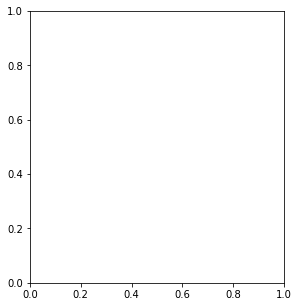

In [201]:
for eid in range(0,17):
    pplot.figure(figsize = (10,5))
    pplot.subplot(1,2,1)
    valsx = np.vstack([np.abs(np.fft.fft(ff[:,0])[0:1279])**0.5 for ff in femto_dataset.X[femto_dataset.eid==eid][0:100]]).T
    valsy = np.vstack([np.abs(np.fft.fft(ff[:,0])[0:1279])**0.5 for ff in femto_dataset.X[femto_dataset.eid==eid][0:100]]).T
    pplot.pcolor(valsx, cmap='gray')
    pplot.title("%i spectrogram"%eid)
    pplot.subplot(1,2,2)
    pplot.plot(np.mean(valsx,1))
    pplot.plot(np.mean(valsy,1))
    pplot.show()

In [202]:
targets =[t for t in inds_exp_target if t not in inds_exp_target]

In [203]:
femto_dataset.inds_exp_target

[0, 5, 6, 8, 9, 10, 12, 13, 14]

In [214]:

def plot_experiments(experiments_to_plot, eval_mode = "safe", nseq_len = None, xaxis_sample = False):
    #training = inds_exp_source
    nsampled = 500

    pplot.figure(figsize = (15,int(10/3*len(experiments_to_plot))), dpi = 600)
    nnodes_list = [1,5,10]#,3,5]
    if nseq_len is None:
        nseq_len = [200,200,200]
    
    minspacing= [10,10,10]
    gnsteps  = [ 7,7,7]
    
    normalization_factor_time = femto_dataset.normalization_factor_time
    kk = 0;
    for ee in experiments_to_plot:
        for nnodes, gnsteps_,nseq_,minspacing_ in zip(nnodes_list, gnsteps, nseq_len, minspacing):
                
            #ee = training[0]
            graphs, y_times = get_graph_data(ee, X_ = femto_dataset.X, eid_oh_ = femto_dataset.eid_oh,
                                             yrem_norm_ = femto_dataset.yrem_norm, n_sampled_graphs = nsampled, 
                                             nnodes=nnodes, fixed_spacing_indices=False, min_spacing=minspacing_,
                                             nseq_range=nseq_)
            probs = gn_tot.eval_graphnets(graphs,gnsteps_,eval_mode = eval_mode)
            #eval_graphnets()
            ids_sorted = np.argsort(y_times)
            #time_grid = np.linspace(np.min(y_times),np.max(y_times), 150);
            time_grid = np.linspace(np.min(y_times), 75000./normalization_factor_time, 150)
            #time_grid = np.linspace(np.min(y_times),3.5, 150);

            e_y = probs.mean()
            p_y = probs.prob(time_grid).numpy().T

            y_times_sorted = y_times[ids_sorted];
            y_times_sorted_unnorm = y_times_sorted * normalization_factor_time;
            pplot.subplot( len(experiments_to_plot),len(nnodes_list), kk+1)
            q90 = np.quantile(probs.sample(1000).numpy(),[0.05,0.95],0)[:,:,0].T[ids_sorted]
            
            if xaxis_sample:
                pplot.pcolor([r for r in range(p_y.shape[1])], time_grid*normalization_factor_time, p_y[:,ids_sorted]**0.5, cmap = "gray")
            else:
                pplot.pcolor(y_times_sorted_unnorm, time_grid*normalization_factor_time, p_y[:,ids_sorted]**0.5, cmap = "gray")
                pplot.plot(y_times_sorted_unnorm, y_times_sorted  *normalization_factor_time)
            

            #pplot.plot(e_y.numpy()[ids_sorted]*normalization_factor_time,'C1',label = "$E[t_f]$",alpha = 0.5)<3
            pplot.plot(y_times_sorted_unnorm,q90*femto_dataset.normalization_factor_time,'C1-.', alpha = 0.4)
            pplot.ylim(0,75000)
            pplot.xlabel("Actual time to failure [s]")
            pplot.ylabel("Predicted time to failure [s]")

            nll = -np.mean(probs.log_prob(y_times[np.newaxis].T))

            title = "Experiment %i (%s)\n Observations:%i \nnll:%2.3f"%(ee,femto_dataset.file_suffix[ee],nnodes,nll)
            pplot.title(title)
            kk+=1
            #p_y.shape
            #pplot.show()
    pplot.subplots_adjust(hspace = 0.65, wspace = 0.5)
    #pplot.show()
    

In [215]:

# def plot_experiments(experiments_to_plot, eval_mode = "safe", nseq_len = None):
#     #training = inds_exp_source
#     nsampled = 500

#     pplot.figure(figsize = (15,10), dpi = 600)
#     nnodes_list = [1,5,10]#,3,5]
#     if nseq_len is None:
#         nseq_len = [200,200,200]
    
#     minspacing= [10,10,10]
#     gnsteps  = [ 5,5,5]
    
#     normalization_factor_time = femto_dataset.normalization_factor_time
#     kk = 0;
#     for ee in experiments_to_plot:
#         for nnodes, gnsteps_,nseq_,minspacing_ in zip(nnodes_list, gnsteps, nseq_len, minspacing):
                
#             #ee = training[0]
#             graphs, y_times = get_graph_data(ee, X_ = femto_dataset.X, eid_oh_ = femto_dataset.eid_oh,
#                                              yrem_norm_ = femto_dataset.yrem_norm, n_sampled_graphs = nsampled, 
#                                              nnodes=nnodes, fixed_spacing_indices=False, min_spacing=minspacing_,
#                                              nseq_range=nseq_)
#             probs = gn_tot.eval_graphnets(graphs,gnsteps_,eval_mode = eval_mode)
#             #eval_graphnets()
#             ids_sorted = np.argsort(y_times)
#             time_grid = np.linspace(np.min(y_times),np.max(y_times), 150);
#             time_grid = np.linspace(np.min(y_times), 60000./normalization_factor_time, 150)
#             #time_grid = np.linspace(np.min(y_times),3.5, 150);

#             e_y = probs.mean()
#             p_y = probs.prob(time_grid).numpy().T

#             y_times_sorted = y_times[ids_sorted];
#             pplot.subplot( len(experiments_to_plot),len(nnodes_list), kk+1)
#             pplot.pcolor([r for r in range(p_y.shape[1])], time_grid*normalization_factor_time, p_y[:,ids_sorted]**0.5, cmap = "gray")
#             pplot.plot(y_times_sorted  *normalization_factor_time)
#             q90 = np.quantile(probs.sample(1000).numpy(),[0.05,0.95],0)[:,:,0].T[ids_sorted]

#             #pplot.plot(e_y.numpy()[ids_sorted]*normalization_factor_time,'C1',label = "$E[t_f]$",alpha = 0.5)<3
#             pplot.plot(q90*femto_dataset.normalization_factor_time,'C1-.', alpha = 0.4)
#             pplot.ylim(0,75000)
#             pplot.xlabel("Sample")
#             pplot.ylabel("Time to failure [s]")

#             nll = -np.mean(probs.log_prob(y_times[np.newaxis].T))

#             title = "Experiment %i (%s)\n Observations:%i \nnll:%2.3f"%(ee,,femto_dataset.file_suffix[ee],nnodes,nll)
#             pplot.title(title)
#             kk+=1
#             #p_y.shape
#             #pplot.show()
#     pplot.subplots_adjust(hspace = 0.65, wspace = 0.5)
#     pplot.show()
    

target


KeyboardInterrupt: 

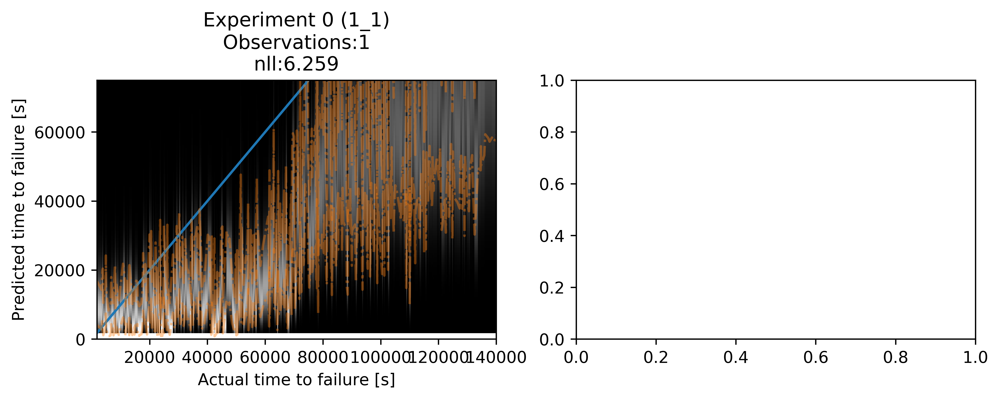

In [216]:
#unseen =  inds_exp_source[3:6]#[4:7]#inds_exp_source[0:3] #inds_exp_target[0:3]
unseen = targets[0:3]#[0:1]#inds_exp_source[0:3] #inds_exp_target[0:3]
print("target")
plot_experiments(inds_target[0:3])
pplot.savefig("graphnet_result_testset.png")
print("source:")
plot_experiments(inds_exp_source[0:3])
pplot.savefig("graphnet_result_trainset.png")

In [206]:
inds_exp_target, inds_exp_source
#ii = []
non_training =[ v_ for v_ in np.unique(femto_dataset.eid) if v_ not in femto_dataset.inds_exp_source]

In [207]:
# all_files = femto_dataset.all_files
# counts_dict = femto_dataset.counts_dict
# exp_to_cond_dict = femto_dataset.exp_to_cond_dict
# print("training set:")
# for k,m in [(i,exp_to_cond_dict[i]) for i in inds_exp_source]:
#     print("%02i %i %s %i"%(k,m, all_files[k][5:8],counts_dict[k]))
    
# print("\ntesting set:")
# for k,m in [(i,exp_to_cond_dict[i]) for i in non_training]:
#     print("%02i %i %s %i"%(k,m, all_files[k][5:8],counts_dict[k]))
    
#plot_experiments([10])


In [208]:
# n = Node()
# Graph(n,e)

In [209]:
femto_dataset.inds_exp_source

[2, 1, 3, 4, 7, 11, 15, 16]

In [210]:
femto_dataset.inds_exp_source, non_training

([2, 1, 3, 4, 7, 11, 15, 16], [0, 5, 6, 8, 9, 10, 12, 13, 14])

In [211]:
non_training

[0, 5, 6, 8, 9, 10, 12, 13, 14]

In [ ]:
eid = 6;
Xv = femto_dataset.X[femto_dataset.eid == eid]
yrem = femto_dataset.yrem_s_raw[femto_dataset.eid == eid]
sc = 1.5

i1,i2,i3 = [0,int(4*len(Xv)/5),-10]
pplot.figure(figsize = tuple(np.array([6,2])*sc))

pplot.subplot(1,3,1)
pplot.plot(Xv[i1,:,0], alpha = 0.5)
pplot.title("rem=%2.3f"%(yrem[i1]))

pplot.subplot(1,3,2)
pplot.plot(Xv[i2,:,0])
pplot.title("rem=%2.3f"%(yrem[i2]))

pplot.subplot(1,3,3)
pplot.plot(Xv[i3,:,0])
pplot.title("rem=%2.3f"%(yrem[i3]))

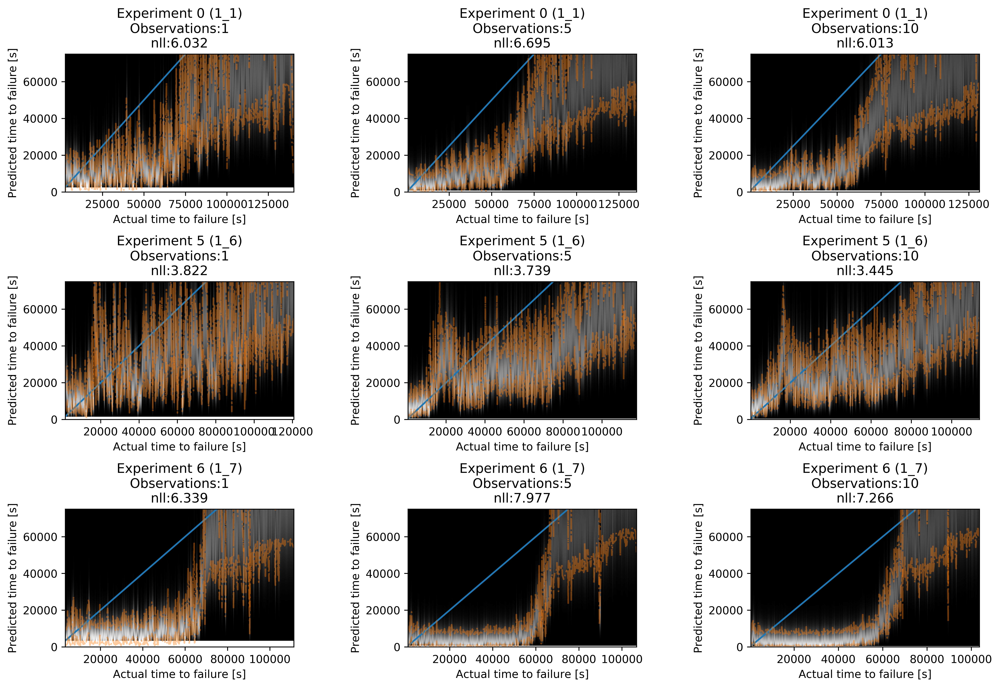

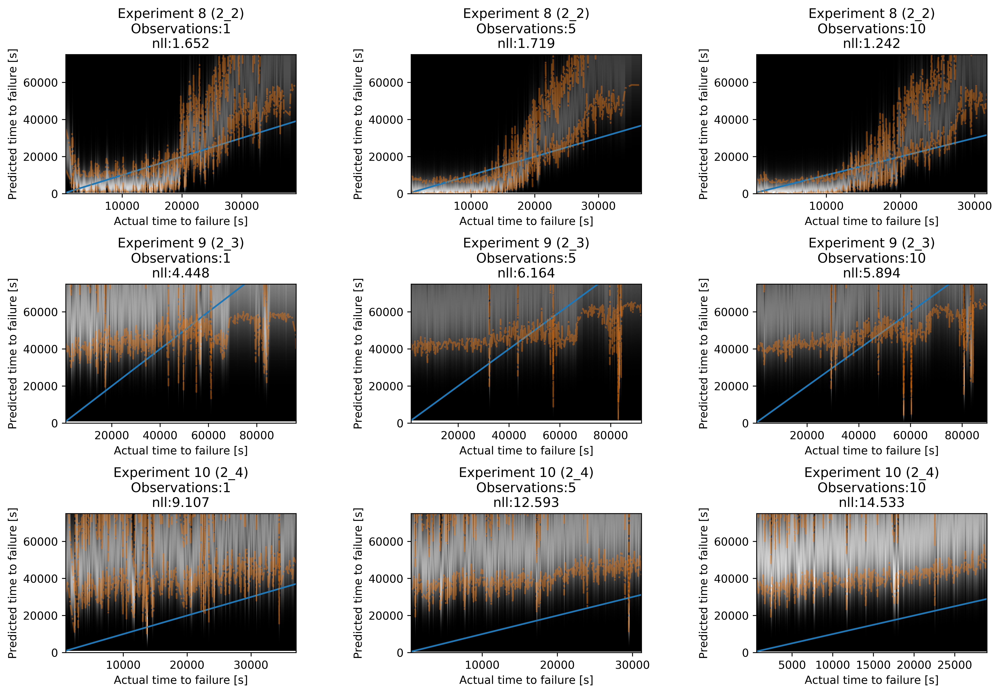

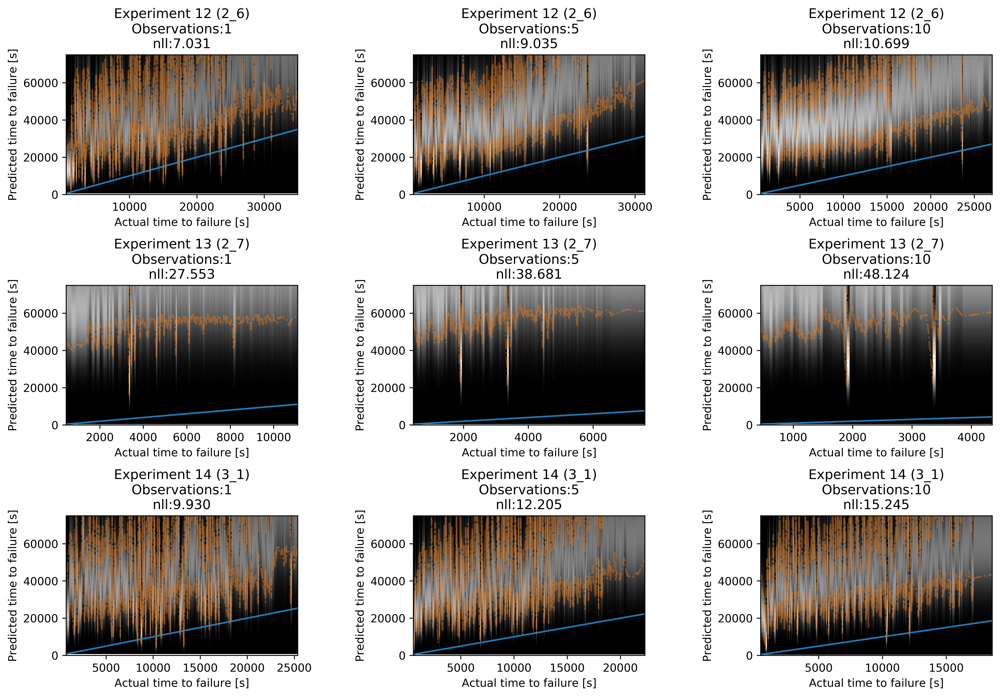

<Figure size 9000x0 with 0 Axes>

In [217]:
suff = 'b50'
#plot_experiments(targets[0:2])
plot_experiments(non_training[0:3],nseq_len=[100,150,200])
pplot.savefig("TestSet_Exp_1_%s.png"%suff)
#pplot.savefig("TestSet_Exp_1_b.pdf")

plot_experiments(non_training[3:6],nseq_len=[100,150,200])
pplot.savefig("TestSet_Exp_2_%s.png"%suff)
#pplot.savefig("TestSet_Exp_2_b.pdf")

plot_experiments(non_training[6:9],nseq_len=[100,150,200])
pplot.savefig("TestSet_Exp_3_%s.png"%suff)
#pplot.savefig("TestSet_Exp_3_b.pdf")

plot_experiments(non_training[9:],nseq_len=[100,150,200])



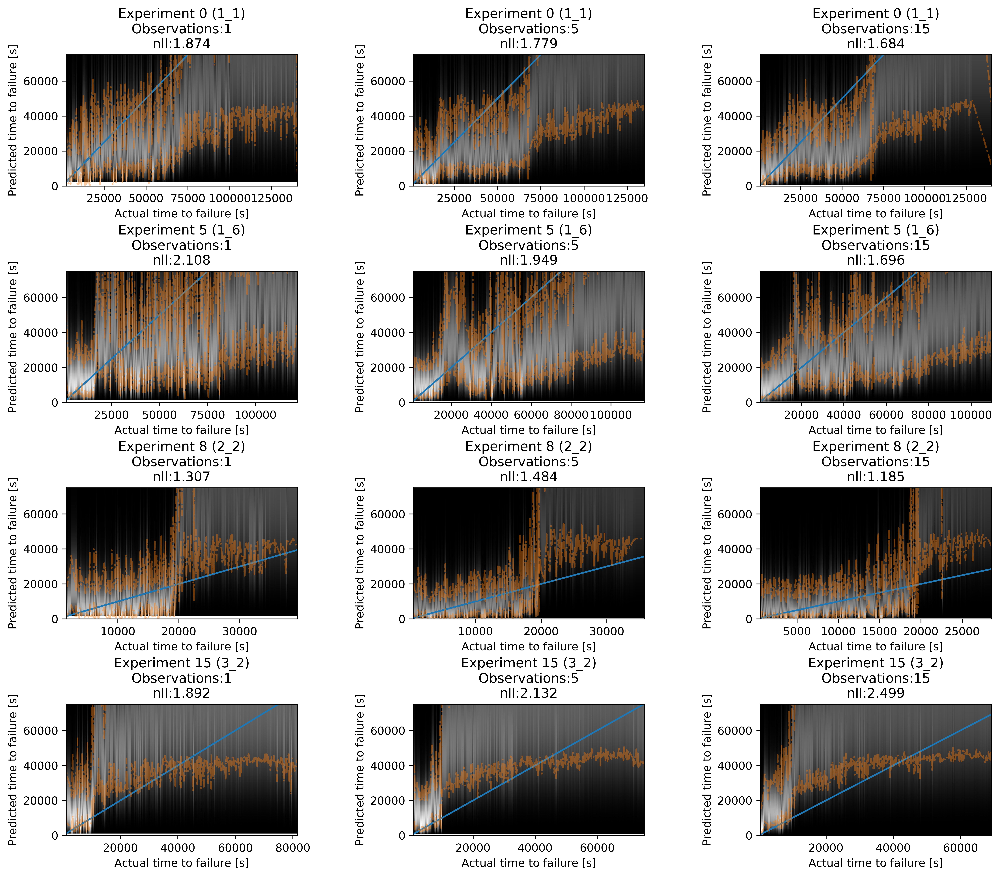

In [63]:
tt = [non_training[k_] for k_ in [0,1,3,8]]
plot_experiments(tt, nseq_len=[100,150,250])
pplot.savefig("test_set_examples_2.png")

Help on method bootstrap_eval_graphnets in module graphnet_utils:

bootstrap_eval_graphnets(graph_data_, iterations=5, n_bootstrap_samples=1, n_nodes_keep=5, eval_mode='batched', return_final_node=False, node_index_to_use=-1) method of graphnet_utils.GraphNetFunctionFactory instance
    Evaluate multiple random samples of nodes from the past. 
    The signature is alsmost the same as `eval_graphnets` with the difference of the parameters n_boostrap_samples (how many times to resample the past nodes) and n_nodes_keep 
    (how many nodes from the past to keep). The last node is always in the computed sample.



In [105]:
for m in range(len(inds_exp_source)):
    x_ = X[np.argmax(eid_oh,axis=-1) == inds_exp_source[m]]
    v = graph_indep.node_function.predict([np.zeros([x_.shape[0],1]),x_], batch_size = 100)
    pplot.plot(v[:,3], label = m)
pplot.legend()

NameError: name 'X' is not defined

In [48]:
plot_experiments(inds_exp_target)
#plot_experiments(inds_exp_target[2:])


NameError: name 'plot_experiments' is not defined

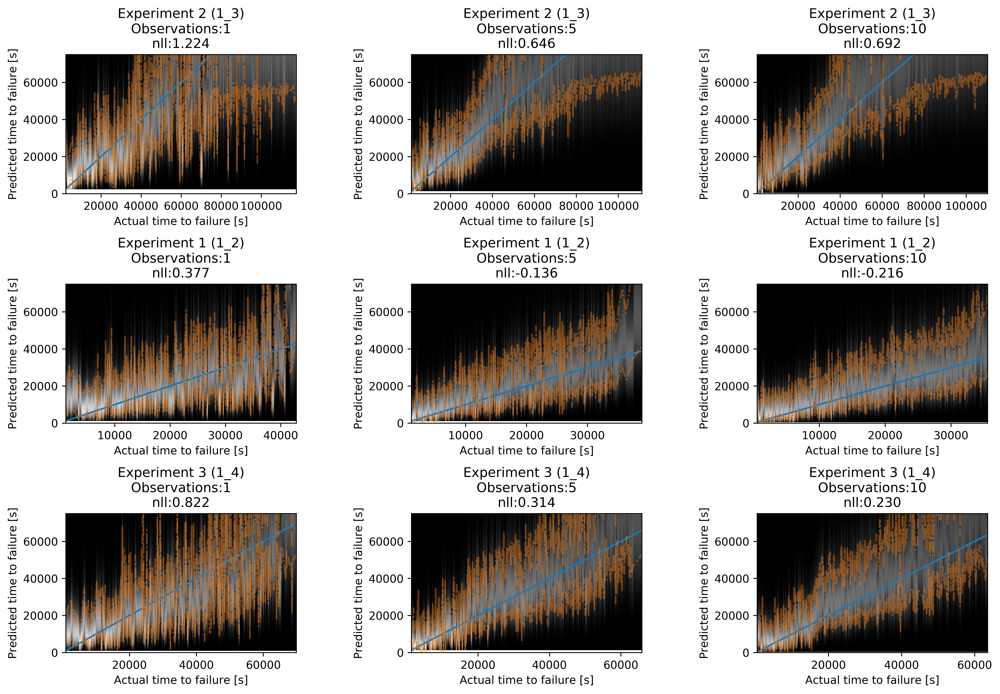

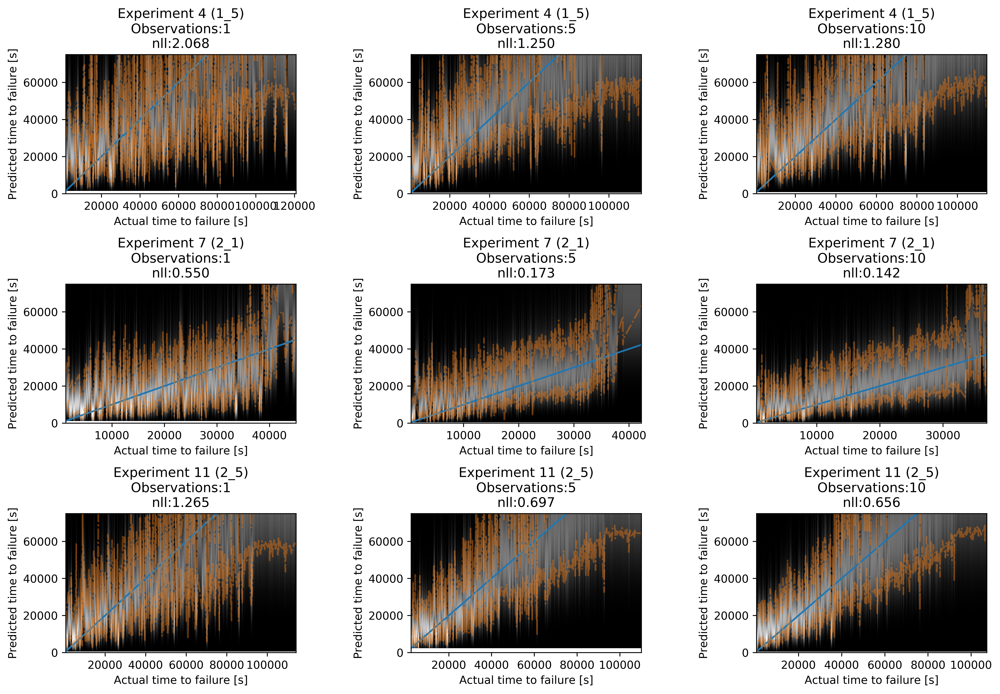

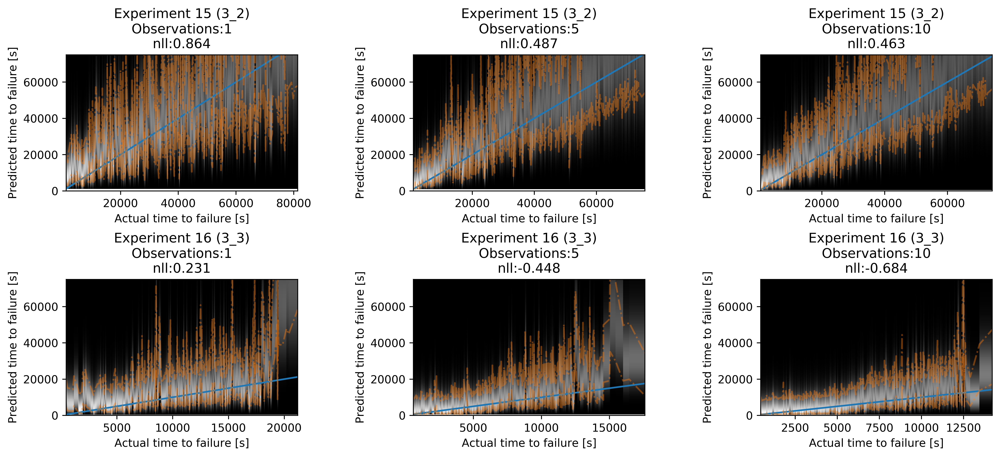

In [184]:

plot_experiments(inds_exp_source[0:3])
plot_experiments(inds_exp_source[3:6])
plot_experiments(inds_exp_source[6:])

#plot_experiments(inds_exp_source[6:])



# Results on unseen data:

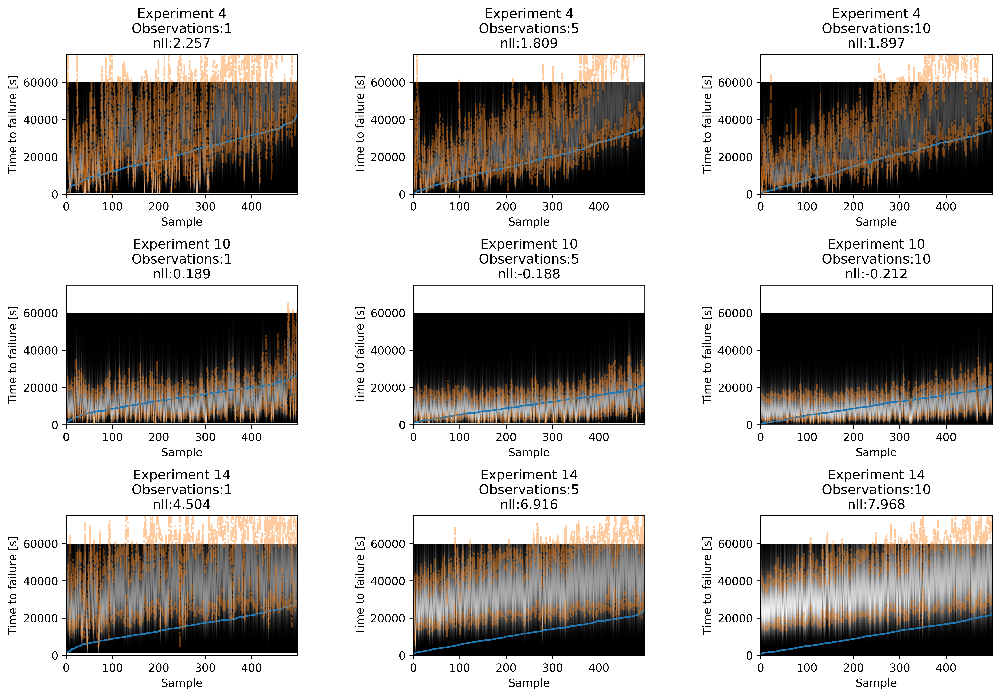

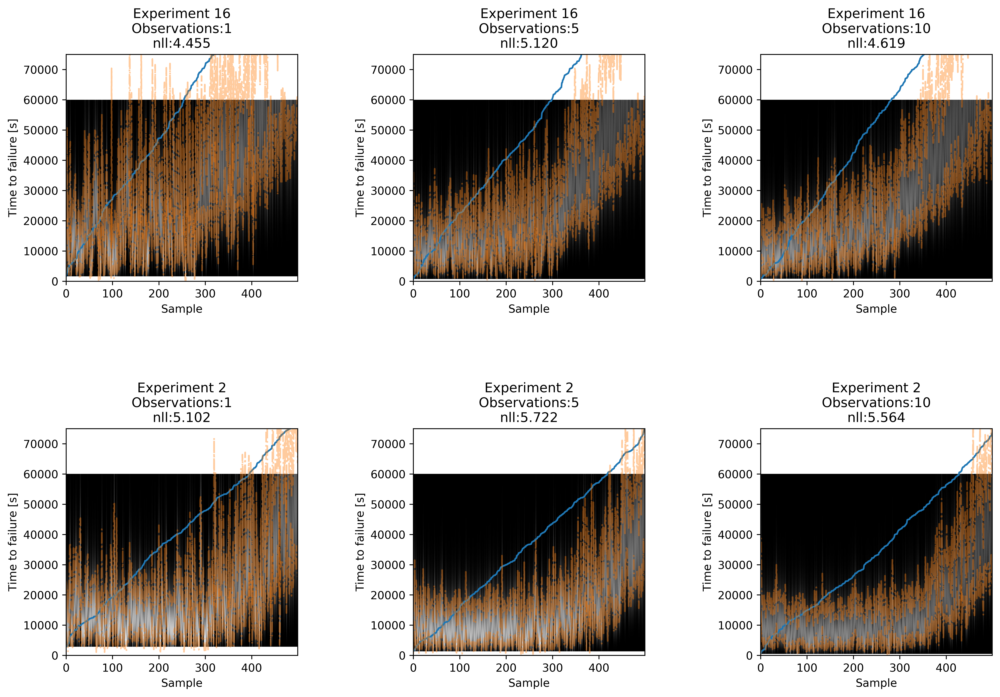

In [98]:

#plot_experiments(inds_exp_target[0:3])
plot_experiments([4,10,14])
plot_experiments(femto_dataset.inds_exp_target)


In [52]:
femto_dataset.inds_exp_source

[5, 6, 7, 8, 13, 15, 3, 12]

In [100]:

inds_exp_target

[16, 2, 8]

In [83]:
femto_dataset.inds_exp_source

[0, 2, 3, 7, 8, 11, 14]

In [183]:
v_ = [inds_exp_source[k] for k in [0,1,2,3,4,5]] 
v1= [femto_dataset.exp_to_cond_dict[v__] for v__ in v_]
print(v_,v1)


[1, 5, 6, 7, 9, 13] [0, 0, 0, 1, 1, 1]


In [ ]:
XX = femto_dataset.X[femto_dataset.eid == inds_exp_source[2]]
XX2 = femto_dataset.X[femto_dataset.eid == inds_exp_source[5]]
pplot.plot(np.hstack(XX[:,:,0]))
pplot.show()
t1 = gn_tot.graph_indep.node_function([np.random.randn(1,1),XX[0::10,:,:]])
t2 = gn_tot.graph_indep.node_function([np.random.randn(1,1),XX2[0::10,:,:]])
#XX.shape

#gn_tot.graph_indep.node_function.summary()